# FDA course Project : Analysis of School and School teacher Data of Gujarat (2019-20)
Analyzing the data of Number of Teachers by Gender, Academic Qualification, Professional Qualification, Classes Taught, School Category and School Management in Districts of Gujarat during 2019-20

In [436]:
import sqlite3 as sql3
import pandas as pd
import matplotlib.pyplot as plt
import tzdata
import plotnine as p9 
import numpy as np 
from glob import glob
import plotly.express as px

# Using sqlite3, tables from the Database are fetched

In [ ]:
conn=sql3.connect("C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/Guj_teacher.db") 
c=conn.cursor()

Master Table- school teacher is fetch containing all columns

In [438]:
query1=c.execute("select * from school_teacher").fetchall()
for i in query1:
  print(i)

('', 'Academic_Year', 'State_Code', 'State_Name', 'District_Code', 'District_Name', 'Block_Code', 'Block_Name', 'School_Management_Id', 'School_Management_Name', 'School_Category_Id', 'School_Category_Name', 'Academic_Qualification_Id', 'Academic_Qualification_Name', 'Professional_Qualification_Id', 'Professional_Qualification_Name', 'Only_Pre_Primary_Male', 'Only_Pre_Primary_Female', 'Pre_Primary_and_Primary_Male', 'Pre_Primary_and_Primary_Female', 'Only_Primary_Male', 'Only_Primary_Female', 'Primary_and_Upperprimary_Male', 'Primary_and_Upperprimary_Female', 'Only_Upperprimary_Male', 'Only_Upperprimary_Female', 'Upperprimary_and_Secondary_Male', 'Upperprimary_and_Secondary_Female', 'Only_Secondary_Male', 'Only_Secondary_Female', 'Secondary_and_Highersecondary_Male', 'Secondary_and_Highersecondary_Female', 'Only_Highersecondary_Male', 'Only_Highersecondary_Female', 'Total_Teacher', 'Total_Male', 'Total_Female')
('0', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240706', 'DASCROI',

('171', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240712', 'AMC', '4', 'Government Aided', '10', 'HSS (IX-XII)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '778', '360', '23', '19', '710', '326', '2216', '1511', '705')
('172', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240713', 'DHOLERA', '4', 'Government Aided', '10', 'HSS (IX-XII)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '6', '0', '1', '0', '2', '0', '9', '9', '0')
('173', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240704', 'SANAND', '4', 'Government Aided', '11', 'HSS (XI-XII)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '10', '0', '10', '10', '0')
('174', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240706', 'DASCROI', '4', 'Government Aided', '11', 'HSS (XI-XII)', '4', 'Graduate', '3', 'B.Ed. or eq

('288', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240701', 'MANDAL', '4', 'Government Aided', '8', 'SS (IX-X)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '2', '1', '1')
('289', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240704', 'SANAND', '4', 'Government Aided', '8', 'SS (IX-X)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('290', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240705', 'CITY', '4', 'Government Aided', '8', 'SS (IX-X)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '0', '0', '0', '0', '3', '3', '0')
('291', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240706', 'DASCROI', '4', 'Government Aided', '8', 'SS (IX-X)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '

('386', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240703', 'VIRAMGAM', '92', 'Kendriya Vidyalaya / Central School', '3', 'HSS (I-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '2', '0', '0', '0', '4', '4', '0')
('387', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240705', 'CITY', '92', 'Kendriya Vidyalaya / Central School', '3', 'HSS (I-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('388', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240706', 'DASCROI', '92', 'Kendriya Vidyalaya / Central School', '3', 'HSS (I-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '3', '0', '0', '1', '0', '0', '0', '2', '4', '3', '0', '1', '1', '15', '7', '8')
('389', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240712', 'AMC', '92', 'Kendriya Vidyalaya / Centr

('726', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240712', 'AMC', '10', 'Local body', '4', 'UPS (VI-VIII)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '2', '13', '0', '0', '0', '0', '0', '0', '0', '0', '15', '2', '13')
('727', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240712', 'AMC', '10', 'Local body', '2', 'UPS (I-VIII)', '5', 'Post graduate', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '5', '0', '0', '0', '0', '0', '0', '0', '0', '5', '0', '5')
('728', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240712', 'AMC', '10', 'Local body', '4', 'UPS (VI-VIII)', '5', 'Post graduate', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '1', '2', '0', '0', '0', '0', '0', '0', '0', '0', '3', '1', '2')
('729', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240712', 'A

('1017', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240704', 'SANAND', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '3', '0', '0', '0', '3', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '8', '2', '6')
('1018', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240705', 'CITY', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '2', '1', '12', '0', '0', '0', '0', '0', '0', '0', '2', '0', '1', '0', '0', '18', '1', '17')
('1019', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240706', 'DASCROI', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '1', '0', '1', '9', '0', '0', '0',

('1376', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240704', 'SANAND', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '0', '0', '0', '0', '3', '2', '1')
('1377', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240705', 'CITY', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '19', '38', '0', '0', '0', '0', '57', '19', '38')
('1378', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240706', 'DASCROI', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '10', '23', '0', '0', '0', '0', '33', '10', '23')
('1379', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240707', 'DHOLKA', '5', 'Private Unaided (Recognized)', '8', 'SS (IX

('1527', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240710', 'BAVLA', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '6', 'M.Phil', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('1528', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240705', 'CITY', '5', 'Private Unaided (Recognized)', '10', 'HSS (IX-XII)', '6', 'M.Phil', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2', '2', '0')
('1529', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240706', 'DASCROI', '5', 'Private Unaided (Recognized)', '10', 'HSS (IX-XII)', '6', 'M.Phil', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '1', '0', '3', '1', '2')
('1530', '2019-20', '24', 'Gujarat', '2407', 'AHMEDABAD', '240712', 'AMC', '5', 'Private Unaided (Recognized)', '10', 'HSS (IX-XII)', '6', 'M.Phil', '4

('174', '2019-20', '24', 'Gujarat', '2429', 'DEVBHOOMI DWARKA', '242903', 'JAMKALYANPUR', '3', 'Local body', '1', 'PS (I-V)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '3', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '5', '3', '2')
('175', '2019-20', '24', 'Gujarat', '2429', 'DEVBHOOMI DWARKA', '242904', 'JAMKHAMBHALIYA', '3', 'Local body', '1', 'PS (I-V)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '2', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '2', '1')
('176', '2019-20', '24', 'Gujarat', '2429', 'DEVBHOOMI DWARKA', '242901', 'BHANVAD', '3', 'Local body', '2', 'UPS (I-VIII)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '12', '2', '1', '1', '27', '20', '0', '0', '0', '0', '0', '0', '0', '0', '63', '40', '23')
('177', '2019-20', '24', 'Gujarat', '2429', 'DEVBHOOMI DWARKA', '242902', 'DWARKA', '3', 'Local body', '2', 'UPS (I-VIII)', '4', 'Graduate', '3', 'B.Ed. or equivalen

('265', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241802', 'GARBADA', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '28', '20', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '48', '28', '20')
('266', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241803', 'LIMKHEDA', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '41', '20', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '61', '41', '20')
('267', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241804', 'DHANPUR', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '40', '19', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '59', '40', '19

('358', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241808', 'SANJELI', '3', 'Local body', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '29', '14', '0', '0', '14', '4', '0', '0', '0', '0', '0', '0', '0', '0', '61', '43', '18')
('359', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241809', 'SINGVAD', '3', 'Local body', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '80', '39', '0', '0', '18', '5', '0', '0', '0', '0', '0', '0', '0', '0', '142', '98', '44')
('360', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241801', 'DAHOD', '3', 'Local body', '1', 'PS (I-V)', '3', 'Higher secondary', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '7', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '8', '7', '1')
('361', '2019-20'

('857', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241807', 'DEV.BARIA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '3', '7', '0', '0', '1', '3', '0', '0', '0', '0', '0', '0', '0', '0', '14', '4', '10')
('858', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241808', 'SANJELI', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '1')
('859', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241801', 'DAHOD', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '1', '0', '1', '0', '0', '0', '0', '1', '2', '1', '1', '8', '2', '6')
('860', '2019-20', '24', 'Gujarat', '2418', 'DOHAD', '241803', 'LIMKHEDA', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '5', '

('176', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240603', 'KALOL', '92', 'Kendriya Vidyalaya / Central School', '3', 'HSS (I-XII)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '3', '0', '0', '0', '0', '0', '0', '5', '1', '0', '0', '1', '0', '11', '7', '4')
('177', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240602', 'GANDHINAGAR', '92', 'Kendriya Vidyalaya / Central School', '3', 'HSS (I-XII)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '3', '1', '2')
('178', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240602', 'GANDHINAGAR', '92', 'Kendriya Vidyalaya / Central School', '3', 'HSS (I-XII)', '4', 'Graduate', '5', 'Others', '0', '0', '0', '0', '2', '2', '0', '0', '1', '0', '1', '0', '2', '0', '0', '0', '0', '0', '8', '6', '2')
('179', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240602', 'GANDHINAGAR', '92', 'Kendriya Vidyalaya / Central S

('631', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240602', 'GANDHINAGAR', '5', 'Private Unaided (Recognized)', '1', 'PS (I-V)', '5', 'Post graduate', '6', 'None', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('632', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240604', 'MANSA', '5', 'Private Unaided (Recognized)', '1', 'PS (I-V)', '5', 'Post graduate', '6', 'None', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('633', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240601', 'DEHGAM', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '6', 'None', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('634', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240602', 'GANDHINAGAR', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '6', 'Non

('736', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240602', 'GANDHINAGAR', '2', 'Tribal Welfare Department', '10', 'HSS (IX-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '4', '0', '0', '1', '5', '11', '2', '9')
('737', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240602', 'GANDHINAGAR', '2', 'Tribal Welfare Department', '10', 'HSS (IX-XII)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '2', '0', '2')
('738', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240601', 'DEHGAM', '2', 'Tribal Welfare Department', '2', 'UPS (I-VIII)', '5', 'Post graduate', '5', 'Others', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('739', '2019-20', '24', 'Gujarat', '2406', 'GANDHINAGAR', '240602', 'GANDHINAGAR', '2', 'Tribal Welfare Department', '10', 'HSS (IX-

('632', '2019-20', '24', 'Gujarat', '2430', 'GIR SOMNATH', '243002', 'VERAVAL', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '2', '1', '1')
('633', '2019-20', '24', 'Gujarat', '2430', 'GIR SOMNATH', '243004', 'UNA', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '1', '1', '3', '1', '2')
('634', '2019-20', '24', 'Gujarat', '2430', 'GIR SOMNATH', '243005', 'KODINAR', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '1', '0', '3', '1', '2')
('635', '2019-20', '24', 'Gujarat', '2430', 'GIR SOMNATH', '243006', 'GIRGADHADA', '5', 'Private Unaided (Recognized)', '3', 'HS

('654', '2019-20', '24', 'Gujarat', '2410', 'JAMNAGAR', '241008', 'JODIYA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('655', '2019-20', '24', 'Gujarat', '2410', 'JAMNAGAR', '241009', 'KALAVAD', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('656', '2019-20', '24', 'Gujarat', '2410', 'JAMNAGAR', '241010', 'LALPUR', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '2', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '2', '1')
('657', '2019-20', '24', 'Gujarat', '2410', 'JAMNAGAR', '241002', 'DHROL', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', 

('449', '2019-20', '24', 'Gujarat', '2412', 'JUNAGADH', '241206', 'MALIYA HATINA', '3', 'Local body', '2', 'UPS (I-VIII)', '6', 'M.Phil', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('450', '2019-20', '24', 'Gujarat', '2412', 'JUNAGADH', '241201', 'JUNAGADH', '3', 'Local body', '2', 'UPS (I-VIII)', '6', 'M.Phil', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('451', '2019-20', '24', 'Gujarat', '2412', 'JUNAGADH', '241206', 'MALIYA HATINA', '3', 'Local body', '2', 'UPS (I-VIII)', '6', 'M.Phil', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '1', '3', '0', '0', '0', '0', '0', '0', '0', '0', '5', '1', '4')
('452', '2019-20', '24', 'Gujarat', '2412', 'JUNAGADH', '241207', 'MANGROL', '3', 'Local body', '2', 'UPS (I-VIII)', '6', 'M.Phil', '3', 'B.Ed. or equivalent', '0', '0'

('1075', '2019-20', '24', 'Gujarat', '2412', 'JUNAGADH', '241216', 'JUNAGADH CORPORATION', '90', 'Social welfare Department', '2', 'UPS (I-VIII)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2')
('1076', '2019-20', '24', 'Gujarat', '2412', 'JUNAGADH', '241208', 'KESHOD', '90', 'Social welfare Department', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '1')
('1077', '2019-20', '24', 'Gujarat', '2412', 'JUNAGADH', '241216', 'JUNAGADH CORPORATION', '90', 'Social welfare Department', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '

('274', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240104', 'ANJAR', '4', 'Government Aided', '10', 'HSS (IX-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '8', '4', '4', '0', '5', '0', '21', '17', '4')
('275', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240105', 'BHUJ', '4', 'Government Aided', '10', 'HSS (IX-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '25', '14', '2', '0', '19', '15', '75', '46', '29')
('276', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240106', 'NAKHATRANA', '4', 'Government Aided', '10', 'HSS (IX-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '8', '7', '1', '0', '6', '11', '33', '15', '18')
('277', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240107', 'ABDASA', '4', 'Government Aided', '10', 'HSS (IX-XII)', '5', 'Post graduate', '3', 'B.Ed.

('621', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240103', 'BHACHAU', '3', 'Local body', '2', 'UPS (I-VIII)', '5', 'Post graduate', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '2', '0', '0', '3', '2', '0', '0', '0', '0', '0', '0', '0', '0', '7', '3', '4')
('622', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240104', 'ANJAR', '3', 'Local body', '2', 'UPS (I-VIII)', '5', 'Post graduate', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '1', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '2', '1')
('623', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240105', 'BHUJ', '3', 'Local body', '2', 'UPS (I-VIII)', '5', 'Post graduate', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '4', '0', '0', '0', '3', '2', '0', '0', '0', '0', '0', '0', '0', '0', '9', '7', '2')
('624', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240106', 'NAKHATRANA', '3', 'Local body', '2', 'UPS (I-VIII)', '

('979', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240104', 'ANJAR', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '4', 'Graduate', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '1', '0', '0', '2', '2', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '7', '2', '5')
('980', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240108', 'MANDVI', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '4', 'Graduate', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('981', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240109', 'MUNDRA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '4', 'Graduate', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '4', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '5', '0', '5')
('982', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240110', 'GANDHIDHAM', '

('1404', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240105', 'BHUJ', '5', 'Private Unaided (Recognized)', '10', 'HSS (IX-XII)', '5', 'Post graduate', '8', 'Pursuing any relevant professional course', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '1', '0', '1')
('1405', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240110', 'GANDHIDHAM', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '6', 'M.Phil', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1', '1', '0')
('1406', '2019-20', '24', 'Gujarat', '2401', 'KACHCHH', '240110', 'GANDHIDHAM', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '6', 'M.Phil', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('1407', '2019-20', '24', 'Gujarat', '2401', 'KACHC

('350', '2019-20', '24', 'Gujarat', '2416', 'KHEDA', '241603', 'KATHLAL', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '59', '22', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '81', '59', '22')
('351', '2019-20', '24', 'Gujarat', '2416', 'KHEDA', '241604', 'KHEDA', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '10', '11', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '21', '10', '11')
('352', '2019-20', '24', 'Gujarat', '2416', 'KHEDA', '241605', 'MAHEMDAVAD', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '45', '40', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '85', '45', '40

('1077', '2019-20', '24', 'Gujarat', '2416', 'KHEDA', '241608', 'NADIAD', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '5', 'Others', '0', '0', '0', '0', '2', '2', '0', '0', '2', '4', '0', '0', '0', '0', '0', '0', '0', '0', '10', '4', '6')
('1078', '2019-20', '24', 'Gujarat', '2416', 'KHEDA', '241609', 'THASARA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '5', 'Others', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('1079', '2019-20', '24', 'Gujarat', '2416', 'KHEDA', '241611', 'GALTESHWAR', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '5', 'Others', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2')
('1080', '2019-20', '24', 'Gujarat', '2416', 'KHEDA', '241612', 'VASO', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '5', 'Others', '0', 

('806', '2019-20', '24', 'Gujarat', '2404', 'MAHESANA', '240402', 'KADI', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '4', '0', '0', '0', '0', '6', '2', '4')
('807', '2019-20', '24', 'Gujarat', '2404', 'MAHESANA', '240403', 'KHERALU', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '2', '2', '0')
('808', '2019-20', '24', 'Gujarat', '2404', 'MAHESANA', '240404', 'MEHSANA', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '7', '2', '0', '0', '0', '0', '9', '7', '2')
('809', '2019-20', '24', 'Gujarat', '2404', 'MAHESANA', '240405', 'SATLASANA', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '4', 'Graduate', '3', '

('91', '2019-20', '24', 'Gujarat', '2413', 'AMRELI', '241302', 'BABARA', '4', 'Government Aided', '10', 'HSS (IX-XII)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('92', '2019-20', '24', 'Gujarat', '2413', 'AMRELI', '241304', 'DHARI', '4', 'Government Aided', '10', 'HSS (IX-XII)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1', '1', '0')
('93', '2019-20', '24', 'Gujarat', '2413', 'AMRELI', '241305', 'JAFRABAD', '4', 'Government Aided', '10', 'HSS (IX-XII)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '2', '2', '0')
('94', '2019-20', '24', 'Gujarat', '2413', 'AMRELI', '241307', 'KUKAVAV', '4', 'Government Aided', '10', 'HSS (IX-XII)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0'

('850', '2019-20', '24', 'Gujarat', '2413', 'AMRELI', '241303', 'BAGASARA', '5', 'Private Unaided (Recognized)', '6', 'SS (I-X)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2')
('851', '2019-20', '24', 'Gujarat', '2413', 'AMRELI', '241311', 'SAVARKUNDLA', '5', 'Private Unaided (Recognized)', '6', 'SS (I-X)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '1', '0', '1')
('852', '2019-20', '24', 'Gujarat', '2413', 'AMRELI', '241301', 'AMRELI', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0',

('123', '2019-20', '24', 'Gujarat', '2420', 'NARMADA', '242004', 'TILAKVADA', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '34', '20', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '54', '34', '20')
('124', '2019-20', '24', 'Gujarat', '2420', 'NARMADA', '242005', 'GARUDESHWAR', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '29', '18', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '47', '29', '18')
('125', '2019-20', '24', 'Gujarat', '2420', 'NARMADA', '242001', 'NANDOD', '3', 'Local body', '2', 'UPS (I-VIII)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '37', '54', '0', '0', '4', '2', '0', '0', '0', '0', '0', '0', '0', '0', '

('470', '2019-20', '24', 'Gujarat', '2420', 'NARMADA', '242003', 'SAGBARA', '2', 'Tribal Welfare Department', '10', 'HSS (IX-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '1', '0', '2', '2', '0')
('471', '2019-20', '24', 'Gujarat', '2420', 'NARMADA', '242005', 'GARUDESHWAR', '2', 'Tribal Welfare Department', '10', 'HSS (IX-XII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0', '0', '0', '2', '4', '1', '3')
('472', '2019-20', '24', 'Gujarat', '2420', 'NARMADA', '242002', 'DEDIYAPADA', '2', 'Tribal Welfare Department', '2', 'UPS (I-VIII)', '5', 'Post graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('473', '2019-20', '24', 'Gujarat', '2420', 'NARMADA', '242005', 'GARUDESHWAR', '2', 'Tribal Welfare Department', '5', 'HSS (VI-XII)'

('342', '2019-20', '24', 'Gujarat', '2424', 'NAVSARI', '242402', 'GANDEVI', '3', 'Local body', '2', 'UPS (I-VIII)', '7', 'Ph.D', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('343', '2019-20', '24', 'Gujarat', '2424', 'NAVSARI', '242403', 'JALALPOR', '3', 'Local body', '2', 'UPS (I-VIII)', '7', 'Ph.D', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '2', '0')
('344', '2019-20', '24', 'Gujarat', '2424', 'NAVSARI', '242402', 'GANDEVI', '5', 'Private Unaided (Recognized)', '1', 'PS (I-V)', '1', 'Below Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '1', '0', '0', '0', '0', '4', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '5', '1', '4')
('345', '2019-20', '24', 'Gujarat', '2424', 'NAVSARI', '242403', 'JALALPOR', '5', 'Private Unaided (Recognized)', '2', '

('385', '2019-20', '24', 'Gujarat', '2417', 'PANCH MAHALS', '241706', 'KALOL', '3', 'Local body', '1', 'PS (I-V)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '1')
('386', '2019-20', '24', 'Gujarat', '2417', 'PANCH MAHALS', '241709', 'MORVA HADAF', '3', 'Local body', '1', 'PS (I-V)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('387', '2019-20', '24', 'Gujarat', '2417', 'PANCH MAHALS', '241701', 'GHOGHAMBA', '3', 'Local body', '2', 'UPS (I-VIII)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '3', '3', '0', '0', '57', '43', '0', '0', '0', '0', '0', '0', '0', '0', '106', '60', '46')
('388', '2019-20', '24', 'Gujarat', '2417', 'PANCH MAHALS', '241702', 'GODHRA', '3', 'Local body', '2', 'UPS (I-VIII)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', 

('385', '2019-20', '24', 'Gujarat', '2403', 'PATAN', '240309', 'SANTALPUR', '3', 'Local body', '2', 'UPS (I-VIII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '38', '34', '1', '0', '39', '17', '0', '0', '0', '0', '0', '0', '0', '0', '129', '78', '51')
('386', '2019-20', '24', 'Gujarat', '2403', 'PATAN', '240311', 'SHANKHESHWAR', '3', 'Local body', '2', 'UPS (I-VIII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '9', '4', '0', '0', '22', '3', '0', '0', '0', '0', '0', '0', '0', '0', '38', '31', '7')
('387', '2019-20', '24', 'Gujarat', '2403', 'PATAN', '240312', 'SARASWATI', '3', 'Local body', '2', 'UPS (I-VIII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '9', '15', '0', '0', '35', '27', '0', '0', '0', '0', '0', '0', '0', '

('212', '2019-20', '24', 'Gujarat', '2411', 'PORBANDAR', '241101', 'PORBANDAR', '5', 'Private Unaided (Recognized)', '1', 'PS (I-V)', '3', 'Higher secondary', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('213', '2019-20', '24', 'Gujarat', '2411', 'PORBANDAR', '241101', 'PORBANDAR', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '3', 'B.Ed. or equivalent', '0', '1', '0', '0', '2', '9', '0', '0', '1', '6', '0', '0', '0', '0', '0', '0', '0', '0', '19', '3', '16')
('214', '2019-20', '24', 'Gujarat', '2411', 'PORBANDAR', '241102', 'RANAVAV', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '3', 'B.Ed. or equivalent', '0', '1', '0', '0', '0', '2', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '4', '1', '3')
('215', '2019-20', '24', 'Gujarat', '2411', 'PORBANDAR', '241103', 'KUTIYANA', '5', 'Private Unaided (Recognized)', 

('581', '2019-20', '24', 'Gujarat', '2409', 'RAJKOT', '240905', 'JETPUR', '10', 'Local body', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '1')
('582', '2019-20', '24', 'Gujarat', '2409', 'RAJKOT', '240915', 'RAJKOT CORPORATION', '10', 'Local body', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '2', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '3')
('583', '2019-20', '24', 'Gujarat', '2409', 'RAJKOT', '240913', 'UPLETA', '10', 'Local body', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '5', 'Others', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '1')
('584', '2019-20', '24', 'Gujarat', '2409', 'RAJKOT', '240915', 'RAJKOT CORPORATION', '10', 'Local body', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '5', 'Others', '0', '0', '0', 

('1321', '2019-20', '24', 'Gujarat', '2409', 'RAJKOT', '240910', 'PADDHARI', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '0', '0', '0', '3', '0', '3')
('1322', '2019-20', '24', 'Gujarat', '2409', 'RAJKOT', '240911', 'RAJKOT', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '6', '3', '0', '0', '0', '0', '9', '6', '3')
('1323', '2019-20', '24', 'Gujarat', '2409', 'RAJKOT', '240913', 'UPLETA', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '5', '4', '0', '0', '0', '0', '9', '5', '4')
('1324', '2019-20', '24', 'Gujarat', '2409', 'RAJKOT', '240915', 'RAJKOT CORPORATION', '5', 'Private Unaided (Recognized)', '8', 'SS (IX-X)', '

('466', '2019-20', '24', 'Gujarat', '2405', 'SABAR KANTHA', '240507', 'HIMMATNAGAR', '3', 'Local body', '2', 'UPS (I-VIII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '4', '1', '0', '0', '89', '51', '0', '0', '0', '0', '0', '0', '0', '0', '145', '93', '52')
('467', '2019-20', '24', 'Gujarat', '2405', 'SABAR KANTHA', '240508', 'PRANTIJ', '3', 'Local body', '2', 'UPS (I-VIII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '47', '17', '0', '0', '0', '0', '0', '0', '0', '0', '64', '47', '17')
('468', '2019-20', '24', 'Gujarat', '2405', 'SABAR KANTHA', '240509', 'TALOD', '3', 'Local body', '2', 'UPS (I-VIII)', '5', 'Post graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '3', '1', '0', '0', '43', '29', '0', '0', '0', '0', '0', '0', '0', '0', '76', '46', '30')
('469', '2019-20', '24', 'Gujarat', '2405', 'SABAR KANTHA', '240514', 'POSHINA', '3', 'Local body', '2', 'UPS (I-VIII)', '5', 'Post graduate', '3', 'B.Ed.

('171', '2019-20', '24', 'Gujarat', '2422', 'SURAT', '242209', 'PALASANA', '4', 'Government Aided', '4', 'UPS (VI-VIII)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('172', '2019-20', '24', 'Gujarat', '2422', 'SURAT', '242202', 'CHORYASI', '4', 'Government Aided', '8', 'SS (IX-X)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('173', '2019-20', '24', 'Gujarat', '2422', 'SURAT', '242203', 'KAMREJ', '4', 'Government Aided', '8', 'SS (IX-X)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', 

('1216', '2019-20', '24', 'Gujarat', '2422', 'SURAT', '242209', 'PALASANA', '5', 'Private Unaided (Recognized)', '6', 'SS (I-X)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '1', '0', '0', '1', '0', '0', '0', '0', '3', '1', '2')
('1217', '2019-20', '24', 'Gujarat', '2422', 'SURAT', '242215', 'SURAT CORPO.', '5', 'Private Unaided (Recognized)', '6', 'SS (I-X)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '1', '0', '8', '0', '1', '0', '5', '0', '0', '0', '0', '0', '0', '0', '0', '15', '0', '15')
('1218', '2019-20', '24', 'Gujarat', '2422', 'SURAT', '242215', 'SURAT CORPO.', '5', 'Private Unaided (Recognized)', '7', 'SS (VI-X)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', 

('436', '2019-20', '24', 'Gujarat', '2408', 'SURENDRANAGAR', '240803', 'PATDI - DASADA', '3', 'Local body', '4', 'UPS (VI-VIII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('437', '2019-20', '24', 'Gujarat', '2408', 'SURENDRANAGAR', '240806', 'MULI', '3', 'Local body', '4', 'UPS (VI-VIII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '7', '3', '0', '0', '0', '0', '0', '0', '0', '0', '10', '7', '3')
('438', '2019-20', '24', 'Gujarat', '2408', 'SURENDRANAGAR', '240807', 'CHOTILA', '3', 'Local body', '4', 'UPS (VI-VIII)', '4', 'Graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0

('156', '2019-20', '24', 'Gujarat', '2415', 'ANAND', '241505', 'PETLAD', '4', 'Government Aided', '4', 'UPS (VI-VIII)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('157', '2019-20', '24', 'Gujarat', '2415', 'ANAND', '241503', 'BORSAD', '4', 'Government Aided', '5', 'HSS (VI-XII)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '2', '2', '0')
('158', '2019-20', '24', 'Gujarat', '2415', 'ANAND', '241501', 'ANAND', '4', 'Government Aided', '7', 'SS (VI-X)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('159', '2019-20', '24', 'Gujarat', '2415', 'ANAND', '241501', 'ANAND', '4', 'Government Aided', '8', 'SS (IX-X)', '4', 'Graduate', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('848', '2019-20', '24', 'Gujarat', '2425', 'VALSAD', '242501', 'VALSAD', '5', 'Private Unaided (Recognized)', '6', 'SS (I-X)', '7', 'Ph.D', '7', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('849', '2019-20', '24', 'Gujarat', '2425', 'VALSAD', '242506', 'VAPI', '5', 'Private Unaided (Recognized)', '10', 'HSS (IX-XII)', '7', 'Ph.D', '7', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '1', '0', '1')
('850', '2019-20', '24', 'Gujarat', '2425', 'VALSAD', '242506', 'VAPI', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '8', 'Post Doctoral', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('851', '2019-20', '24', 'Gujarat', '2425', 'VALSAD', '242501', 'VALSAD', '5', 'Private Unaided (Recognized)', '10', 'HSS (IX-XII)',

('407', '2019-20', '24', 'Gujarat', '2427', 'ARAVALLI', '242703', 'MEGHRAJ', '5', 'Private Unaided (Recognized)', '1', 'PS (I-V)', '3', 'Higher secondary', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '3')
('408', '2019-20', '24', 'Gujarat', '2427', 'ARAVALLI', '242701', 'MODASA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '3', 'Higher secondary', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2')
('409', '2019-20', '24', 'Gujarat', '2427', 'ARAVALLI', '242701', 'MODASA', '5', 'Private Unaided (Recognized)', '3', 'HSS (I-XII)', '3', 'Higher secondary', '2', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('410', '2019-20', '24', 'Gujarat', '2427', 'ARAVALLI', 

('323', '2019-20', '24', 'Gujarat', '2402', 'BANAS KANTHA', '240210', 'THARAD', '4', 'Government Aided', '5', 'HSS (VI-XII)', '6', 'M.Phil', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1', '1', '0')
('324', '2019-20', '24', 'Gujarat', '2402', 'BANAS KANTHA', '240205', 'DEESA', '4', 'Government Aided', '10', 'HSS (IX-XII)', '6', 'M.Phil', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1', '1', '0')
('325', '2019-20', '24', 'Gujarat', '2402', 'BANAS KANTHA', '240209', 'PALANPUR', '4', 'Government Aided', '10', 'HSS (IX-XII)', '6', 'M.Phil', '4', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '1', '0', '2', '2', '0')
('326', '2019-20', '24', 'Gujarat', '2402', 'BANAS KANTHA', '240210', 'THARAD', '4', 'Government Aided', '10', 'HSS (IX-XII)', '6', 'M.Phil', '4', 'M.Ed. or equivalent', '0', 

('1238', '2019-20', '24', 'Gujarat', '2402', 'BANAS KANTHA', '240204', 'DANTIWADA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '4', 'Graduate', '5', 'Others', '0', '0', '0', '0', '1', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '2', '0')
('1239', '2019-20', '24', 'Gujarat', '2402', 'BANAS KANTHA', '240205', 'DEESA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '4', 'Graduate', '5', 'Others', '0', '0', '0', '0', '1', '2', '0', '1', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '6', '3', '3')
('1240', '2019-20', '24', 'Gujarat', '2402', 'BANAS KANTHA', '240206', 'DEODAR', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '4', 'Graduate', '5', 'Others', '0', '0', '0', '0', '5', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '6', '6', '0')
('1241', '2019-20', '24', 'Gujarat', '2402', 'BANAS KANTHA', '240207', 'DHANERA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '4', 'Graduate', '5', 'Others'

('232', '2019-20', '24', 'Gujarat', '2421', 'BHARUCH', '242104', 'HANSOT', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '7', '14', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '21', '7', '14')
('233', '2019-20', '24', 'Gujarat', '2421', 'BHARUCH', '242105', 'JAMBUSAR', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '31', '10', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '41', '31', '10')
('234', '2019-20', '24', 'Gujarat', '2421', 'BHARUCH', '242106', 'VAGRA', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '1', '4', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '5', '1', '4')
(

('67', '2019-20', '24', 'Gujarat', '2414', 'BHAVNAGAR', '241404', 'UMRALA', '13', 'Department of Education', '8', 'SS (IX-X)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '0', '0', '0', '0', '3', '3', '0')
('68', '2019-20', '24', 'Gujarat', '2414', 'BHAVNAGAR', '241405', 'BHAVNAGAR', '13', 'Department of Education', '8', 'SS (IX-X)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('69', '2019-20', '24', 'Gujarat', '2414', 'BHAVNAGAR', '241411', 'MAHUVA', '13', 'Department of Education', '8', 'SS (IX-X)', '4', 'Graduate', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '2', '2', '0')
('70', '2019-20', '24', 'Gujarat', '2414', 'BHAVNAGAR', '241413', 'JESAR', '13', 'Department of Education', '8', 'SS (IX-X)', '4', 'Graduate', '3', 'B.Ed. or equivale

('943', '2019-20', '24', 'Gujarat', '2414', 'BHAVNAGAR', '241409', 'PALITANA', '5', 'Private Unaided (Recognized)', '1', 'PS (I-V)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '1', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '4', '3', '1')
('944', '2019-20', '24', 'Gujarat', '2414', 'BHAVNAGAR', '241405', 'BHAVNAGAR', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '1', '10', '0', '0', '5', '2', '0', '0', '0', '0', '0', '0', '0', '0', '18', '6', '12')
('945', '2019-20', '24', 'Gujarat', '2414', 'BHAVNAGAR', '241406', 'GHOGHA', '5', 'Private Unaided (Recognized)', '2', 'UPS (I-VIII)', '5', 'Post graduate', '1', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '1

('168', '2019-20', '24', 'Gujarat', '2432', 'CHHOTAUDEPUR', '243204', 'NASWADI', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('169', '2019-20', '24', 'Gujarat', '2432', 'CHHOTAUDEPUR', '243206', 'BODELI', '3', 'Local body', '1', 'PS (I-V)', '2', 'Secondary', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('170', '2019-20', '24', 'Gujarat', '2432', 'CHHOTAUDEPUR', '243201', 'CHHOTA-UDEPUR', '3', 'Local body', '2', 'UPS (I-VIII)', '2', 'Secondary', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '3', '0')
('171', '2019-20', '24', 'Gujarat', '2432', 'CHHOTAUDEPUR', '243203', 'KAWANT', '3', 'Local body', '2', 'UPS (I-VIII)', '2', 'Secondary', '3', 'B.Ed. or equivalent', '0', '0', '0', '0', '

# 3NF Table

Dependent column from the master table are made into tables so that partial dependency can be removed.
Dependency of the columns are as below
Academic_Qualification_Name ---> Academic_Qualification_Id
Block_Name ---> Block_Code
District_Name ---> District_Code
Professional_Qualification_Name ---> Professional_Qualification_Id
School_Category_Name ---> School_Category_Id
School_Management_Name ---> School_Management_Id

In [439]:
query1=c.execute("select * from academic_qualification").fetchall()
for i in query1:
  print(i)

('Academic_Qualification_Id', 'Academic_Qualification_Name')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('6', 'M.Phil')
('7', 'Ph.D')
('4', 'Graduate')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post 

('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3

('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Gra

('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('4', 'Graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('1', 'Below Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate'

('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Highe

('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Gra

('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Gra

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('6', 'M.Phil')
('7', 'Ph.D')
('4', 'Graduate')
('5', 'Post graduate')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Gr

('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'H

('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post gradua

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post

('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Highe

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('8', 'Post Doctoral')
('5', 'Post graduate')
('1', 'Below Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', '

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('

('6', 'M.Phil')
('6', 'M.Phil')
('7', 'Ph.D')
('4', 'Graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', '

('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('8', 'Post Doctoral')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2'

('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('

('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 

('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('

('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Highe

('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('1', 'Below Secondary')
('1', 'Below Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher sec

('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate'

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('3', 'Higher secondary')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary'

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post

('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secon

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post

('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Hig

('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('6', 'M.Phil')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('8', 'Post Doctoral')
('8', 'Post Doctoral')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('6', 'M.Phil')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('7', 'Ph.D')
('7', 'Ph.D')
('7', 'Ph.D')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', 'Below Secondary')
('1', '

('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher 

('1', 'Below Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3'

('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Gra

('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('2', 'Secondary')
('3', 'Higher secondary')
('3', 'Higher secondary'

('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post

('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Gra

('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('3', 'Higher secondary')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4'

('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('4', 'Graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post graduate')
('5', 'Post gra

In [440]:
query1=c.execute("select * from block_name").fetchall()
for i in query1:
  print(i)

('Block_Code', 'Block_Name')
('240706', 'DASCROI')
('240703', 'VIRAMGAM')
('240704', 'SANAND')
('240707', 'DHOLKA')
('240710', 'BAVLA')
('240711', 'DHANDHUKA')
('240713', 'DHOLERA')
('240705', 'CITY')
('240712', 'AMC')
('240710', 'BAVLA')
('240712', 'AMC')
('240705', 'CITY')
('240701', 'MANDAL')
('240703', 'VIRAMGAM')
('240704', 'SANAND')
('240706', 'DASCROI')
('240707', 'DHOLKA')
('240710', 'BAVLA')
('240713', 'DHOLERA')
('240705', 'CITY')
('240712', 'AMC')
('240701', 'MANDAL')
('240702', 'DETROJ-RAMPURA')
('240704', 'SANAND')
('240710', 'BAVLA')
('240713', 'DHOLERA')
('240704', 'SANAND')
('240707', 'DHOLKA')
('240710', 'BAVLA')
('240705', 'CITY')
('240712', 'AMC')
('240701', 'MANDAL')
('240702', 'DETROJ-RAMPURA')
('240704', 'SANAND')
('240710', 'BAVLA')
('240713', 'DHOLERA')
('240705', 'CITY')
('240707', 'DHOLKA')
('240705', 'CITY')
('240705', 'CITY')
('240703', 'VIRAMGAM')
('240710', 'BAVLA')
('240710', 'BAVLA')
('240703', 'VIRAMGAM')
('240704', 'SANAND')
('240710', 'BAVLA')
('24070

('240712', 'AMC')
('240705', 'CITY')
('240706', 'DASCROI')
('240712', 'AMC')
('240705', 'CITY')
('240706', 'DASCROI')
('240712', 'AMC')
('240703', 'VIRAMGAM')
('240704', 'SANAND')
('240705', 'CITY')
('240706', 'DASCROI')
('240707', 'DHOLKA')
('240710', 'BAVLA')
('240711', 'DHANDHUKA')
('240712', 'AMC')
('240704', 'SANAND')
('240705', 'CITY')
('240706', 'DASCROI')
('240711', 'DHANDHUKA')
('240712', 'AMC')
('240703', 'VIRAMGAM')
('240704', 'SANAND')
('240712', 'AMC')
('240704', 'SANAND')
('240705', 'CITY')
('240706', 'DASCROI')
('240707', 'DHOLKA')
('240712', 'AMC')
('240705', 'CITY')
('240706', 'DASCROI')
('240706', 'DASCROI')
('240705', 'CITY')
('240706', 'DASCROI')
('240707', 'DHOLKA')
('240712', 'AMC')
('240704', 'SANAND')
('240705', 'CITY')
('240712', 'AMC')
('240703', 'VIRAMGAM')
('240705', 'CITY')
('240706', 'DASCROI')
('240711', 'DHANDHUKA')
('240712', 'AMC')
('240703', 'VIRAMGAM')
('240704', 'SANAND')
('240705', 'CITY')
('240706', 'DASCROI')
('240707', 'DHOLKA')
('240712', 'AMC'

('241801', 'DAHOD')
('241802', 'GARBADA')
('241803', 'LIMKHEDA')
('241804', 'DHANPUR')
('241805', 'FATEPURA')
('241806', 'ZALOD')
('241807', 'DEV.BARIA')
('241808', 'SANJELI')
('241809', 'SINGVAD')
('241801', 'DAHOD')
('241802', 'GARBADA')
('241803', 'LIMKHEDA')
('241804', 'DHANPUR')
('241805', 'FATEPURA')
('241806', 'ZALOD')
('241807', 'DEV.BARIA')
('241808', 'SANJELI')
('241809', 'SINGVAD')
('241801', 'DAHOD')
('241802', 'GARBADA')
('241803', 'LIMKHEDA')
('241804', 'DHANPUR')
('241806', 'ZALOD')
('241807', 'DEV.BARIA')
('241808', 'SANJELI')
('241801', 'DAHOD')
('241802', 'GARBADA')
('241803', 'LIMKHEDA')
('241804', 'DHANPUR')
('241805', 'FATEPURA')
('241806', 'ZALOD')
('241807', 'DEV.BARIA')
('241808', 'SANJELI')
('241809', 'SINGVAD')
('241801', 'DAHOD')
('241803', 'LIMKHEDA')
('241804', 'DHANPUR')
('241805', 'FATEPURA')
('241806', 'ZALOD')
('241807', 'DEV.BARIA')
('241808', 'SANJELI')
('241809', 'SINGVAD')
('241801', 'DAHOD')
('241802', 'GARBADA')
('241803', 'LIMKHEDA')
('241804', '

('240603', 'KALOL')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240604', 'MANSA')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240603', 'KALOL')
('240604', 'MANSA')
('240602', 'GANDHINAGAR')
('240602', 'GANDHINAGAR')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240603', 'KALOL')
('240604', 'MANSA')
('240604', 'MANSA')
('240603', 'KALOL')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240603', 'KALOL')
('240604', 'MANSA')
('240602', 'GANDHINAGAR')
('240601', 'DEHGAM')
('240603', 'KALOL')
('240604', 'MANSA')
('240604', 'MANSA')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240603', 'KALOL')
('240604', 'MANSA')
('240602', 'GANDHINAGAR')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240603', 'KALOL')
('240604', 'MANSA')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240603', 'KALOL')
('240604', 'MANSA')
('240601', 'DEHGAM')
('240602', 'GANDHINAGAR')
('240603', 'KALOL')
('240604', 'MANSA')
('240602', 'GANDHINAGAR')
('2406

('243004', 'UNA')
('243005', 'KODINAR')
('243006', 'GIRGADHADA')
('243001', 'TALALA')
('243002', 'VERAVAL')
('243004', 'UNA')
('243005', 'KODINAR')
('243006', 'GIRGADHADA')
('243001', 'TALALA')
('243002', 'VERAVAL')
('243004', 'UNA')
('243002', 'VERAVAL')
('243003', 'SUTRAPADA')
('243005', 'KODINAR')
('243001', 'TALALA')
('243001', 'TALALA')
('243002', 'VERAVAL')
('243003', 'SUTRAPADA')
('243005', 'KODINAR')
('243002', 'VERAVAL')
('243004', 'UNA')
('243006', 'GIRGADHADA')
('243002', 'VERAVAL')
('243004', 'UNA')
('243004', 'UNA')
('243003', 'SUTRAPADA')
('243005', 'KODINAR')
('243001', 'TALALA')
('243002', 'VERAVAL')
('243003', 'SUTRAPADA')
('243004', 'UNA')
('243005', 'KODINAR')
('243001', 'TALALA')
('243002', 'VERAVAL')
('243003', 'SUTRAPADA')
('243004', 'UNA')
('243005', 'KODINAR')
('243006', 'GIRGADHADA')
('243001', 'TALALA')
('243002', 'VERAVAL')
('243003', 'SUTRAPADA')
('243004', 'UNA')
('243005', 'KODINAR')
('243006', 'GIRGADHADA')
('243002', 'VERAVAL')
('243001', 'TALALA')
('243

('241202', 'MENDARDA')
('241206', 'MALIYA HATINA')
('241207', 'MANGROL')
('241209', 'MANAVADAR')
('241210', 'VANTHALI')
('241216', 'JUNAGADH CORPORATION')
('241208', 'KESHOD')
('241206', 'MALIYA HATINA')
('241207', 'MANGROL')
('241208', 'KESHOD')
('241209', 'MANAVADAR')
('241210', 'VANTHALI')
('241216', 'JUNAGADH CORPORATION')
('241216', 'JUNAGADH CORPORATION')
('241216', 'JUNAGADH CORPORATION')
('241216', 'JUNAGADH CORPORATION')
('241216', 'JUNAGADH CORPORATION')
('241216', 'JUNAGADH CORPORATION')
('241216', 'JUNAGADH CORPORATION')
('241207', 'MANGROL')
('241201', 'JUNAGADH')
('241209', 'MANAVADAR')
('241210', 'VANTHALI')
('241211', 'BHESAN')
('241212', 'VISAVADAR')
('241216', 'JUNAGADH CORPORATION')
('241212', 'VISAVADAR')
('241206', 'MALIYA HATINA')
('241211', 'BHESAN')
('241201', 'JUNAGADH')
('241202', 'MENDARDA')
('241206', 'MALIYA HATINA')
('241207', 'MANGROL')
('241208', 'KESHOD')
('241210', 'VANTHALI')
('241212', 'VISAVADAR')
('241216', 'JUNAGADH CORPORATION')
('241201', 'JUNAG

('241202', 'MENDARDA')
('241206', 'MALIYA HATINA')
('241206', 'MALIYA HATINA')
('241210', 'VANTHALI')
('241202', 'MENDARDA')
('241206', 'MALIYA HATINA')
('241206', 'MALIYA HATINA')
('241202', 'MENDARDA')
('241206', 'MALIYA HATINA')
('241210', 'VANTHALI')
('241202', 'MENDARDA')
('241206', 'MALIYA HATINA')
('241210', 'VANTHALI')
('240105', 'BHUJ')
('240105', 'BHUJ')
('240105', 'BHUJ')
('240105', 'BHUJ')
('240105', 'BHUJ')
('240105', 'BHUJ')
('240105', 'BHUJ')
('240102', 'RAPAR')
('240104', 'ANJAR')
('240105', 'BHUJ')
('240110', 'GANDHIDHAM')
('240101', 'LAKHAPAT')
('240102', 'RAPAR')
('240103', 'BHACHAU')
('240104', 'ANJAR')
('240105', 'BHUJ')
('240106', 'NAKHATRANA')
('240108', 'MANDVI')
('240109', 'MUNDRA')
('240110', 'GANDHIDHAM')
('240102', 'RAPAR')
('240103', 'BHACHAU')
('240104', 'ANJAR')
('240105', 'BHUJ')
('240106', 'NAKHATRANA')
('240107', 'ABDASA')
('240108', 'MANDVI')
('240109', 'MUNDRA')
('240110', 'GANDHIDHAM')
('240109', 'MUNDRA')
('240105', 'BHUJ')
('240104', 'ANJAR')
('24

('240109', 'MUNDRA')
('240110', 'GANDHIDHAM')
('240105', 'BHUJ')
('240103', 'BHACHAU')
('240104', 'ANJAR')
('240108', 'MANDVI')
('240109', 'MUNDRA')
('240110', 'GANDHIDHAM')
('240104', 'ANJAR')
('240105', 'BHUJ')
('240106', 'NAKHATRANA')
('240107', 'ABDASA')
('240108', 'MANDVI')
('240109', 'MUNDRA')
('240110', 'GANDHIDHAM')
('240105', 'BHUJ')
('240101', 'LAKHAPAT')
('240103', 'BHACHAU')
('240104', 'ANJAR')
('240105', 'BHUJ')
('240106', 'NAKHATRANA')
('240108', 'MANDVI')
('240109', 'MUNDRA')
('240110', 'GANDHIDHAM')
('240103', 'BHACHAU')
('240105', 'BHUJ')
('240102', 'RAPAR')
('240104', 'ANJAR')
('240105', 'BHUJ')
('240108', 'MANDVI')
('240107', 'ABDASA')
('240109', 'MUNDRA')
('240102', 'RAPAR')
('240103', 'BHACHAU')
('240104', 'ANJAR')
('240105', 'BHUJ')
('240107', 'ABDASA')
('240108', 'MANDVI')
('240110', 'GANDHIDHAM')
('240101', 'LAKHAPAT')
('240102', 'RAPAR')
('240103', 'BHACHAU')
('240104', 'ANJAR')
('240105', 'BHUJ')
('240106', 'NAKHATRANA')
('240107', 'ABDASA')
('240108', 'MANDVI

('241609', 'THASARA')
('241602', 'KAPADVANJ')
('241603', 'KATHLAL')
('241604', 'KHEDA')
('241605', 'MAHEMDAVAD')
('241606', 'MAHUDHA')
('241607', 'MATAR')
('241608', 'NADIAD')
('241609', 'THASARA')
('241611', 'GALTESHWAR')
('241612', 'VASO')
('241608', 'NADIAD')
('241604', 'KHEDA')
('241607', 'MATAR')
('241608', 'NADIAD')
('241609', 'THASARA')
('241611', 'GALTESHWAR')
('241602', 'KAPADVANJ')
('241603', 'KATHLAL')
('241608', 'NADIAD')
('241602', 'KAPADVANJ')
('241603', 'KATHLAL')
('241604', 'KHEDA')
('241605', 'MAHEMDAVAD')
('241607', 'MATAR')
('241609', 'THASARA')
('241611', 'GALTESHWAR')
('241602', 'KAPADVANJ')
('241603', 'KATHLAL')
('241604', 'KHEDA')
('241605', 'MAHEMDAVAD')
('241606', 'MAHUDHA')
('241607', 'MATAR')
('241608', 'NADIAD')
('241609', 'THASARA')
('241611', 'GALTESHWAR')
('241612', 'VASO')
('241602', 'KAPADVANJ')
('241603', 'KATHLAL')
('241604', 'KHEDA')
('241605', 'MAHEMDAVAD')
('241606', 'MAHUDHA')
('241607', 'MATAR')
('241608', 'NADIAD')
('241609', 'THASARA')
('241611

('240408', 'VIJAPUR')
('240409', 'VISNAGAR')
('240407', 'VADNAGAR')
('240407', 'VADNAGAR')
('240406', 'UNJHA')
('240402', 'KADI')
('240402', 'KADI')
('240404', 'MEHSANA')
('240408', 'VIJAPUR')
('240409', 'VISNAGAR')
('240402', 'KADI')
('240404', 'MEHSANA')
('240409', 'VISNAGAR')
('240402', 'KADI')
('240401', 'BECHARAJI')
('240404', 'MEHSANA')
('240407', 'VADNAGAR')
('240402', 'KADI')
('240404', 'MEHSANA')
('240405', 'SATLASANA')
('240406', 'UNJHA')
('240408', 'VIJAPUR')
('240406', 'UNJHA')
('240409', 'VISNAGAR')
('240402', 'KADI')
('240401', 'BECHARAJI')
('240402', 'KADI')
('240404', 'MEHSANA')
('240408', 'VIJAPUR')
('240409', 'VISNAGAR')
('240411', 'JOTANA')
('240404', 'MEHSANA')
('240406', 'UNJHA')
('240407', 'VADNAGAR')
('240408', 'VIJAPUR')
('240401', 'BECHARAJI')
('240402', 'KADI')
('240403', 'KHERALU')
('240404', 'MEHSANA')
('240405', 'SATLASANA')
('240406', 'UNJHA')
('240407', 'VADNAGAR')
('240408', 'VIJAPUR')
('240409', 'VISNAGAR')
('240411', 'JOTANA')
('240401', 'BECHARAJI')
(

('243103', 'LUNAWADA')
('243104', 'SANTRAMPUR')
('243105', 'BALASINOR')
('243106', 'VIRPUR')
('243103', 'LUNAWADA')
('243105', 'BALASINOR')
('243101', 'KADANA')
('243102', 'KHANPUR')
('243103', 'LUNAWADA')
('243104', 'SANTRAMPUR')
('243105', 'BALASINOR')
('243106', 'VIRPUR')
('243101', 'KADANA')
('243103', 'LUNAWADA')
('243104', 'SANTRAMPUR')
('243105', 'BALASINOR')
('243102', 'KHANPUR')
('243103', 'LUNAWADA')
('243104', 'SANTRAMPUR')
('243105', 'BALASINOR')
('243106', 'VIRPUR')
('243103', 'LUNAWADA')
('243104', 'SANTRAMPUR')
('243105', 'BALASINOR')
('243106', 'VIRPUR')
('243101', 'KADANA')
('243102', 'KHANPUR')
('243103', 'LUNAWADA')
('243104', 'SANTRAMPUR')
('243105', 'BALASINOR')
('243106', 'VIRPUR')
('243102', 'KHANPUR')
('243103', 'LUNAWADA')
('243103', 'LUNAWADA')
('243104', 'SANTRAMPUR')
('243103', 'LUNAWADA')
('243101', 'KADANA')
('243103', 'LUNAWADA')
('243104', 'SANTRAMPUR')
('243105', 'BALASINOR')
('243103', 'LUNAWADA')
('243105', 'BALASINOR')
('243101', 'KADANA')
('243102',

('241305', 'JAFRABAD')
('241309', 'LILIYA')
('241310', 'RAJULA')
('241301', 'AMRELI')
('241306', 'KHAMBHA')
('241301', 'AMRELI')
('241302', 'BABARA')
('241303', 'BAGASARA')
('241304', 'DHARI')
('241305', 'JAFRABAD')
('241306', 'KHAMBHA')
('241307', 'KUKAVAV')
('241308', 'LATHI')
('241309', 'LILIYA')
('241311', 'SAVARKUNDLA')
('241301', 'AMRELI')
('241302', 'BABARA')
('241303', 'BAGASARA')
('241304', 'DHARI')
('241305', 'JAFRABAD')
('241306', 'KHAMBHA')
('241307', 'KUKAVAV')
('241308', 'LATHI')
('241309', 'LILIYA')
('241310', 'RAJULA')
('241311', 'SAVARKUNDLA')
('241304', 'DHARI')
('241307', 'KUKAVAV')
('241310', 'RAJULA')
('241311', 'SAVARKUNDLA')
('241301', 'AMRELI')
('241302', 'BABARA')
('241304', 'DHARI')
('241305', 'JAFRABAD')
('241307', 'KUKAVAV')
('241311', 'SAVARKUNDLA')
('241301', 'AMRELI')
('241301', 'AMRELI')
('241301', 'AMRELI')
('241310', 'RAJULA')
('241301', 'AMRELI')
('241302', 'BABARA')
('241306', 'KHAMBHA')
('241307', 'KUKAVAV')
('241308', 'LATHI')
('241308', 'LATHI')
(

('243305', 'HALVAD')
('243304', 'WANKANER')
('243305', 'HALVAD')
('243305', 'HALVAD')
('243304', 'WANKANER')
('243301', 'MORBI')
('243301', 'MORBI')
('243303', 'TANKARA')
('243303', 'TANKARA')
('243301', 'MORBI')
('243302', 'MALIYA')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243303', 'TANKARA')
('243301', 'MORBI')
('243302', 'MALIYA')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243305', 'HALVAD')
('243301', 'MORBI')
('243302', 'MALIYA')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243305', 'HALVAD')
('243301', 'MORBI')
('243303', 'TANKARA')
('243301', 'MORBI')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243302', 'MALIYA')
('243301', 'MORBI')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243301', 'MORBI')
('243301', 'MORBI')
('243304', 'WANKANER')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243302', 'MALIYA')
('243304', 'WANKANER')
('243304', 'WANKANER')
('243303', 'TANKARA')
('243301', 'MORBI')
('243302', 'MALIYA')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243305'

('243303', 'TANKARA')
('243304', 'WANKANER')
('243304', 'WANKANER')
('243305', 'HALVAD')
('243301', 'MORBI')
('243305', 'HALVAD')
('243301', 'MORBI')
('243301', 'MORBI')
('243304', 'WANKANER')
('243305', 'HALVAD')
('243301', 'MORBI')
('243303', 'TANKARA')
('243301', 'MORBI')
('243301', 'MORBI')
('243301', 'MORBI')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243304', 'WANKANER')
('243301', 'MORBI')
('243301', 'MORBI')
('243305', 'HALVAD')
('243304', 'WANKANER')
('243302', 'MALIYA')
('243305', 'HALVAD')
('243301', 'MORBI')
('243301', 'MORBI')
('243301', 'MORBI')
('243303', 'TANKARA')
('243304', 'WANKANER')
('243305', 'HALVAD')
('243301', 'MORBI')
('243301', 'MORBI')
('243304', 'WANKANER')
('243303', 'TANKARA')
('243301', 'MORBI')
('243301', 'MORBI')
('243304', 'WANKANER')
('243304', 'WANKANER')
('243301', 'MORBI')
('243301', 'MORBI')
('243301', 'MORBI')
('242002', 'DEDIYAPADA')
('242001', 'NANDOD')
('242002', 'DEDIYAPADA')
('242003', 'SAGBARA')
('242003', 'SAGBARA')
('242001', 'NANDOD

('242405', 'VANSDA')
('242403', 'JALALPOR')
('242404', 'NAVSARI')
('242405', 'VANSDA')
('242406', 'KHERGAM')
('242401', 'CHIKHLI')
('242404', 'NAVSARI')
('242406', 'KHERGAM')
('242401', 'CHIKHLI')
('242402', 'GANDEVI')
('242404', 'NAVSARI')
('242402', 'GANDEVI')
('242402', 'GANDEVI')
('242404', 'NAVSARI')
('242401', 'CHIKHLI')
('242404', 'NAVSARI')
('242403', 'JALALPOR')
('242404', 'NAVSARI')
('242405', 'VANSDA')
('242401', 'CHIKHLI')
('242403', 'JALALPOR')
('242404', 'NAVSARI')
('242405', 'VANSDA')
('242406', 'KHERGAM')
('242402', 'GANDEVI')
('242403', 'JALALPOR')
('242404', 'NAVSARI')
('242404', 'NAVSARI')
('242402', 'GANDEVI')
('242403', 'JALALPOR')
('242404', 'NAVSARI')
('242405', 'VANSDA')
('242403', 'JALALPOR')
('242404', 'NAVSARI')
('242402', 'GANDEVI')
('242404', 'NAVSARI')
('242405', 'VANSDA')
('242406', 'KHERGAM')
('242402', 'GANDEVI')
('242403', 'JALALPOR')
('242404', 'NAVSARI')
('242401', 'CHIKHLI')
('242405', 'VANSDA')
('242401', 'CHIKHLI')
('242402', 'GANDEVI')
('242403',

('241701', 'GHOGHAMBA')
('241703', 'HALOL')
('241704', 'JAMBUGHODA')
('241709', 'MORVA HADAF')
('241711', 'SHAHERA')
('241703', 'HALOL')
('241711', 'SHAHERA')
('241706', 'KALOL')
('241702', 'GODHRA')
('241701', 'GHOGHAMBA')
('241703', 'HALOL')
('241711', 'SHAHERA')
('241701', 'GHOGHAMBA')
('241703', 'HALOL')
('241704', 'JAMBUGHODA')
('241709', 'MORVA HADAF')
('241701', 'GHOGHAMBA')
('241709', 'MORVA HADAF')
('241702', 'GODHRA')
('241704', 'JAMBUGHODA')
('241701', 'GHOGHAMBA')
('241702', 'GODHRA')
('241703', 'HALOL')
('241704', 'JAMBUGHODA')
('241709', 'MORVA HADAF')
('241711', 'SHAHERA')
('241701', 'GHOGHAMBA')
('241706', 'KALOL')
('241701', 'GHOGHAMBA')
('241702', 'GODHRA')
('241709', 'MORVA HADAF')
('241706', 'KALOL')
('241709', 'MORVA HADAF')
('241701', 'GHOGHAMBA')
('241702', 'GODHRA')
('241703', 'HALOL')
('241702', 'GODHRA')
('241706', 'KALOL')
('241702', 'GODHRA')
('241704', 'JAMBUGHODA')
('241701', 'GHOGHAMBA')
('241702', 'GODHRA')
('241703', 'HALOL')
('241704', 'JAMBUGHODA')
('

('241102', 'RANAVAV')
('241101', 'PORBANDAR')
('241102', 'RANAVAV')
('241101', 'PORBANDAR')
('241102', 'RANAVAV')
('241101', 'PORBANDAR')
('241102', 'RANAVAV')
('241101', 'PORBANDAR')
('241102', 'RANAVAV')
('241102', 'RANAVAV')
('241101', 'PORBANDAR')
('241101', 'PORBANDAR')
('241103', 'KUTIYANA')
('241101', 'PORBANDAR')
('241102', 'RANAVAV')
('241101', 'PORBANDAR')
('241101', 'PORBANDAR')
('241102', 'RANAVAV')
('241102', 'RANAVAV')
('241102', 'RANAVAV')
('241101', 'PORBANDAR')
('241103', 'KUTIYANA')
('241101', 'PORBANDAR')
('241101', 'PORBANDAR')
('241103', 'KUTIYANA')
('241101', 'PORBANDAR')
('241101', 'PORBANDAR')
('241101', 'PORBANDAR')
('241103', 'KUTIYANA')
('241102', 'RANAVAV')
('241103', 'KUTIYANA')
('241102', 'RANAVAV')
('240901', 'DHORAJI')
('240904', 'JASDAN')
('240916', 'VINCHHIYA')
('240901', 'DHORAJI')
('240902', 'GONDAL')
('240905', 'JETPUR')
('240907', 'LODHIKA')
('240910', 'PADDHARI')
('240915', 'RAJKOT CORPORATION')
('240916', 'VINCHHIYA')
('240915', 'RAJKOT CORPORATI

('240903', 'JAMKANDORNA')
('240906', 'KOTDA SANGANI')
('240916', 'VINCHHIYA')
('240905', 'JETPUR')
('240904', 'JASDAN')
('240916', 'VINCHHIYA')
('240905', 'JETPUR')
('240903', 'JAMKANDORNA')
('240902', 'GONDAL')
('240903', 'JAMKANDORNA')
('240904', 'JASDAN')
('240905', 'JETPUR')
('240906', 'KOTDA SANGANI')
('240907', 'LODHIKA')
('240910', 'PADDHARI')
('240911', 'RAJKOT')
('240905', 'JETPUR')
('240913', 'UPLETA')
('240903', 'JAMKANDORNA')
('240910', 'PADDHARI')
('240911', 'RAJKOT')
('240916', 'VINCHHIYA')
('240904', 'JASDAN')
('240915', 'RAJKOT CORPORATION')
('240916', 'VINCHHIYA')
('240907', 'LODHIKA')
('240910', 'PADDHARI')
('240911', 'RAJKOT')
('240913', 'UPLETA')
('240916', 'VINCHHIYA')
('240905', 'JETPUR')
('240913', 'UPLETA')
('240915', 'RAJKOT CORPORATION')
('240901', 'DHORAJI')
('240907', 'LODHIKA')
('240911', 'RAJKOT')
('240904', 'JASDAN')
('240911', 'RAJKOT')
('240915', 'RAJKOT CORPORATION')
('240915', 'RAJKOT CORPORATION')
('240913', 'UPLETA')
('240915', 'RAJKOT CORPORATION')

('240507', 'HIMMATNAGAR')
('240508', 'PRANTIJ')
('240501', 'KHEDBRAHMA')
('240502', 'VIJAYNAGAR')
('240504', 'IDAR')
('240507', 'HIMMATNAGAR')
('240508', 'PRANTIJ')
('240509', 'TALOD')
('240508', 'PRANTIJ')
('240507', 'HIMMATNAGAR')
('240503', 'VADALI')
('240504', 'IDAR')
('240508', 'PRANTIJ')
('240504', 'IDAR')
('240504', 'IDAR')
('240509', 'TALOD')
('240504', 'IDAR')
('240507', 'HIMMATNAGAR')
('240508', 'PRANTIJ')
('240507', 'HIMMATNAGAR')
('240507', 'HIMMATNAGAR')
('240501', 'KHEDBRAHMA')
('240503', 'VADALI')
('240504', 'IDAR')
('240507', 'HIMMATNAGAR')
('240508', 'PRANTIJ')
('240509', 'TALOD')
('240507', 'HIMMATNAGAR')
('240508', 'PRANTIJ')
('240501', 'KHEDBRAHMA')
('240502', 'VIJAYNAGAR')
('240503', 'VADALI')
('240504', 'IDAR')
('240507', 'HIMMATNAGAR')
('240508', 'PRANTIJ')
('240509', 'TALOD')
('240514', 'POSHINA')
('240501', 'KHEDBRAHMA')
('240502', 'VIJAYNAGAR')
('240503', 'VADALI')
('240504', 'IDAR')
('240507', 'HIMMATNAGAR')
('240508', 'PRANTIJ')
('240509', 'TALOD')
('240514'

('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242202', 'CHORYASI')
('242203', 'KAMREJ')
('242204', 'MAHUVA')
('242205', 'MANDAVI')
('242206', 'MANGROL')
('242208', 'OLPAD')
('242209', 'PALASANA')
('242212', 'UMARPADA')
('242215', 'SURAT CORPO.')
('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242201', 'BARDOLI')
('242203', 'KAMREJ')
('242204', 'MAHUVA')
('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242203', 'KAMREJ')
('242205', 'MANDAVI')
('242206', 'MANGROL')
('242209', 'PALASANA')
('242212', 'UMARPADA')
('242215', 'SURAT CORPO.')
('242215', 'SURAT CORPO.')
('242208', 'OLPAD')
('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242204', 'MAHUVA')
('242205', 'MANDAVI')
('242206', 'MANGROL')
('242208', 'OLPAD')
('242209', 'PALASANA')
('242215', 'SURAT CORPO.')
('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242202', 'CHORYASI')
('242203', 'KAMREJ')
('242204', 'MAHUVA')
('242205', 'MANDAVI')
('242206', 'MANGROL')
('242208', 'OLPAD')
('242209', 'PALASANA')
('242215', 'SURAT

('242201', 'BARDOLI')
('242202', 'CHORYASI')
('242203', 'KAMREJ')
('242206', 'MANGROL')
('242208', 'OLPAD')
('242209', 'PALASANA')
('242212', 'UMARPADA')
('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242206', 'MANGROL')
('242209', 'PALASANA')
('242215', 'SURAT CORPO.')
('242202', 'CHORYASI')
('242203', 'KAMREJ')
('242203', 'KAMREJ')
('242208', 'OLPAD')
('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242203', 'KAMREJ')
('242208', 'OLPAD')
('242215', 'SURAT CORPO.')
('242208', 'OLPAD')
('242208', 'OLPAD')
('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242202', 'CHORYASI')
('242203', 'KAMREJ')
('242209', 'PALASANA')
('242215', 'SURAT CORPO.')
('242201', 'BARDOLI')
('242202', 'CHORYASI')
('242203', 'KAMREJ')
('242208', 'OLPAD')
('242209', 'PALASANA')
('242215', 'SURAT CORPO.')
('242215', 'SURAT CORPO.')
('242202', 'CHORYASI')
('242209', 'PALASANA')
('242215', 'SURAT CORPO.')
('242215', 'SURAT CORPO.')
('242215', 'SURAT CORPO.')
('242203', 'KAMREJ')
('242215', 'SURAT CORPO.')
('

('240809', 'CHUDA')
('240810', 'LIMBDI')
('240802', 'DHRANGADHRA')
('240805', 'WADHVAN')
('240806', 'MULI')
('240807', 'CHOTILA')
('240810', 'LIMBDI')
('240802', 'DHRANGADHRA')
('240805', 'WADHVAN')
('240808', 'SAYLA')
('240802', 'DHRANGADHRA')
('240803', 'PATDI - DASADA')
('240805', 'WADHVAN')
('240807', 'CHOTILA')
('240809', 'CHUDA')
('240811', 'THANGADH')
('240802', 'DHRANGADHRA')
('240805', 'WADHVAN')
('240807', 'CHOTILA')
('240808', 'SAYLA')
('240809', 'CHUDA')
('240811', 'THANGADH')
('240802', 'DHRANGADHRA')
('240803', 'PATDI - DASADA')
('240804', 'LAKHTAR')
('240805', 'WADHVAN')
('240806', 'MULI')
('240807', 'CHOTILA')
('240808', 'SAYLA')
('240810', 'LIMBDI')
('240805', 'WADHVAN')
('240807', 'CHOTILA')
('240808', 'SAYLA')
('240809', 'CHUDA')
('240810', 'LIMBDI')
('240805', 'WADHVAN')
('240807', 'CHOTILA')
('240808', 'SAYLA')
('240811', 'THANGADH')
('240805', 'WADHVAN')
('240807', 'CHOTILA')
('240810', 'LIMBDI')
('240802', 'DHRANGADHRA')
('240802', 'DHRANGADHRA')
('240805', 'WADH

('241506', 'SOJITRA')
('241501', 'ANAND')
('241508', 'UMRETH')
('241501', 'ANAND')
('241508', 'UMRETH')
('241501', 'ANAND')
('241503', 'BORSAD')
('241505', 'PETLAD')
('241503', 'BORSAD')
('241501', 'ANAND')
('241503', 'BORSAD')
('241501', 'ANAND')
('241502', 'ANKLAV')
('241503', 'BORSAD')
('241504', 'KHAMBHAT')
('241505', 'PETLAD')
('241506', 'SOJITRA')
('241507', 'TARAPUR')
('241508', 'UMRETH')
('241501', 'ANAND')
('241502', 'ANKLAV')
('241503', 'BORSAD')
('241508', 'UMRETH')
('241501', 'ANAND')
('241503', 'BORSAD')
('241507', 'TARAPUR')
('241501', 'ANAND')
('241501', 'ANAND')
('241507', 'TARAPUR')
('241508', 'UMRETH')
('241501', 'ANAND')
('241503', 'BORSAD')
('241505', 'PETLAD')
('241501', 'ANAND')
('241503', 'BORSAD')
('241504', 'KHAMBHAT')
('241505', 'PETLAD')
('241506', 'SOJITRA')
('241507', 'TARAPUR')
('241501', 'ANAND')
('241503', 'BORSAD')
('241504', 'KHAMBHAT')
('241508', 'UMRETH')
('241501', 'ANAND')
('241503', 'BORSAD')
('241505', 'PETLAD')
('241501', 'ANAND')
('241508', 'UM

('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242302', 'SUBIR')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242302', 'SUBIR')
('242302', 'SUBIR')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242302', 'SUBIR')
('242301', 'AHWA')
('242302', 'SUBIR')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242303', 'WAGHAI')
('242303', 'WAGHAI')
('242301', 'AHWA')
('242303', 'WAGHAI')


('241911', 'VADODARA')
('241912', 'VAGHODIYA')
('241913', 'VADODARA CORPORATION')
('241914', 'DESAR')
('241913', 'VADODARA CORPORATION')
('241902', 'DABHOI')
('241913', 'VADODARA CORPORATION')
('241913', 'VADODARA CORPORATION')
('241902', 'DABHOI')
('241909', 'SAVLI')
('241913', 'VADODARA CORPORATION')
('241904', 'KARJAN')
('241907', 'PADRA')
('241911', 'VADODARA')
('241913', 'VADODARA CORPORATION')
('241902', 'DABHOI')
('241902', 'DABHOI')
('241911', 'VADODARA')
('241913', 'VADODARA CORPORATION')
('241913', 'VADODARA CORPORATION')
('241902', 'DABHOI')
('241913', 'VADODARA CORPORATION')
('241904', 'KARJAN')
('241909', 'SAVLI')
('241911', 'VADODARA')
('241913', 'VADODARA CORPORATION')
('241902', 'DABHOI')
('241907', 'PADRA')
('241911', 'VADODARA')
('241913', 'VADODARA CORPORATION')
('241913', 'VADODARA CORPORATION')
('241914', 'DESAR')
('241913', 'VADODARA CORPORATION')
('241913', 'VADODARA CORPORATION')
('241913', 'VADODARA CORPORATION')
('241911', 'VADODARA')
('241913', 'VADODARA CORP

('242503', 'UMBERGAON')
('242504', 'DHARAMPUR')
('242506', 'VAPI')
('242501', 'VALSAD')
('242502', 'PARDI')
('242503', 'UMBERGAON')
('242506', 'VAPI')
('242501', 'VALSAD')
('242502', 'PARDI')
('242506', 'VAPI')
('242503', 'UMBERGAON')
('242506', 'VAPI')
('242506', 'VAPI')
('242501', 'VALSAD')
('242505', 'KAPARADA')
('242501', 'VALSAD')
('242502', 'PARDI')
('242503', 'UMBERGAON')
('242506', 'VAPI')
('242503', 'UMBERGAON')
('242506', 'VAPI')
('242502', 'PARDI')
('242503', 'UMBERGAON')
('242504', 'DHARAMPUR')
('242505', 'KAPARADA')
('242506', 'VAPI')
('242501', 'VALSAD')
('242502', 'PARDI')
('242503', 'UMBERGAON')
('242504', 'DHARAMPUR')
('242505', 'KAPARADA')
('242506', 'VAPI')
('242501', 'VALSAD')
('242502', 'PARDI')
('242503', 'UMBERGAON')
('242506', 'VAPI')
('242501', 'VALSAD')
('242501', 'VALSAD')
('242501', 'VALSAD')
('242503', 'UMBERGAON')
('242505', 'KAPARADA')
('242501', 'VALSAD')
('242502', 'PARDI')
('242503', 'UMBERGAON')
('242504', 'DHARAMPUR')
('242505', 'KAPARADA')
('242506'

('242706', 'BAYAD')
('242701', 'MODASA')
('242702', 'BHILODA')
('242706', 'BAYAD')
('242701', 'MODASA')
('242702', 'BHILODA')
('242703', 'MEGHRAJ')
('242704', 'MALPUR')
('242705', 'DHANSURA')
('242706', 'BAYAD')
('242701', 'MODASA')
('242702', 'BHILODA')
('242703', 'MEGHRAJ')
('242704', 'MALPUR')
('242706', 'BAYAD')
('242701', 'MODASA')
('242705', 'DHANSURA')
('242706', 'BAYAD')
('242701', 'MODASA')
('242702', 'BHILODA')
('242703', 'MEGHRAJ')
('242706', 'BAYAD')
('242701', 'MODASA')
('242701', 'MODASA')
('242702', 'BHILODA')
('242701', 'MODASA')
('242701', 'MODASA')
('242702', 'BHILODA')
('242701', 'MODASA')
('242702', 'BHILODA')
('242702', 'BHILODA')
('242701', 'MODASA')
('242701', 'MODASA')
('242701', 'MODASA')
('242703', 'MEGHRAJ')
('242704', 'MALPUR')
('242706', 'BAYAD')
('242701', 'MODASA')
('242706', 'BAYAD')
('242701', 'MODASA')
('242702', 'BHILODA')
('242703', 'MEGHRAJ')
('242706', 'BAYAD')
('242701', 'MODASA')
('242701', 'MODASA')
('242701', 'MODASA')
('242702', 'BHILODA')
('2

('240211', 'VADGAM')
('240212', 'VAV')
('240213', 'LAKHANI')
('240214', 'SUIGAM')
('240212', 'VAV')
('240202', 'BHABHAR')
('240203', 'DANTA')
('240204', 'DANTIWADA')
('240205', 'DEESA')
('240206', 'DEODAR')
('240207', 'DHANERA')
('240208', 'KANKAREJ')
('240209', 'PALANPUR')
('240210', 'THARAD')
('240211', 'VADGAM')
('240212', 'VAV')
('240213', 'LAKHANI')
('240214', 'SUIGAM')
('240201', 'AMIRGADH')
('240202', 'BHABHAR')
('240203', 'DANTA')
('240204', 'DANTIWADA')
('240205', 'DEESA')
('240206', 'DEODAR')
('240207', 'DHANERA')
('240208', 'KANKAREJ')
('240209', 'PALANPUR')
('240210', 'THARAD')
('240211', 'VADGAM')
('240212', 'VAV')
('240213', 'LAKHANI')
('240201', 'AMIRGADH')
('240202', 'BHABHAR')
('240203', 'DANTA')
('240204', 'DANTIWADA')
('240205', 'DEESA')
('240206', 'DEODAR')
('240207', 'DHANERA')
('240208', 'KANKAREJ')
('240209', 'PALANPUR')
('240210', 'THARAD')
('240211', 'VADGAM')
('240212', 'VAV')
('240213', 'LAKHANI')
('240214', 'SUIGAM')
('240205', 'DEESA')
('240206', 'DEODAR')


('242107', 'VALIA')
('242107', 'VALIA')
('242102', 'ANKLESHWAR')
('242102', 'ANKLESHWAR')
('242102', 'ANKLESHWAR')
('242102', 'ANKLESHWAR')
('242102', 'ANKLESHWAR')
('242102', 'ANKLESHWAR')
('242103', 'BHARUCH')
('242104', 'HANSOT')
('242105', 'JAMBUSAR')
('242107', 'VALIA')
('242108', 'ZAGHADIA')
('242109', 'NETRANG')
('242102', 'ANKLESHWAR')
('242103', 'BHARUCH')
('242104', 'HANSOT')
('242105', 'JAMBUSAR')
('242107', 'VALIA')
('242108', 'ZAGHADIA')
('242109', 'NETRANG')
('242105', 'JAMBUSAR')
('242102', 'ANKLESHWAR')
('242109', 'NETRANG')
('242102', 'ANKLESHWAR')
('242101', 'AMOD')
('242102', 'ANKLESHWAR')
('242103', 'BHARUCH')
('242104', 'HANSOT')
('242105', 'JAMBUSAR')
('242106', 'VAGRA')
('242107', 'VALIA')
('242108', 'ZAGHADIA')
('242109', 'NETRANG')
('242101', 'AMOD')
('242102', 'ANKLESHWAR')
('242103', 'BHARUCH')
('242104', 'HANSOT')
('242105', 'JAMBUSAR')
('242106', 'VAGRA')
('242107', 'VALIA')
('242108', 'ZAGHADIA')
('242109', 'NETRANG')
('242102', 'ANKLESHWAR')
('242103', 'B

('241411', 'MAHUVA')
('241413', 'JESAR')
('241410', 'TALAJA')
('241406', 'GHOGHA')
('241408', 'GARIYADHAR')
('241409', 'PALITANA')
('241411', 'MAHUVA')
('241413', 'JESAR')
('241406', 'GHOGHA')
('241413', 'JESAR')
('241405', 'BHAVNAGAR')
('241406', 'GHOGHA')
('241407', 'SHIHOR')
('241409', 'PALITANA')
('241410', 'TALAJA')
('241411', 'MAHUVA')
('241402', 'VALLBHIPUR')
('241404', 'UMRALA')
('241405', 'BHAVNAGAR')
('241406', 'GHOGHA')
('241407', 'SHIHOR')
('241408', 'GARIYADHAR')
('241409', 'PALITANA')
('241410', 'TALAJA')
('241411', 'MAHUVA')
('241413', 'JESAR')
('241402', 'VALLBHIPUR')
('241404', 'UMRALA')
('241405', 'BHAVNAGAR')
('241406', 'GHOGHA')
('241407', 'SHIHOR')
('241408', 'GARIYADHAR')
('241409', 'PALITANA')
('241410', 'TALAJA')
('241411', 'MAHUVA')
('241413', 'JESAR')
('241402', 'VALLBHIPUR')
('241404', 'UMRALA')
('241405', 'BHAVNAGAR')
('241406', 'GHOGHA')
('241407', 'SHIHOR')
('241408', 'GARIYADHAR')
('241409', 'PALITANA')
('241410', 'TALAJA')
('241411', 'MAHUVA')
('241413',

('242803', 'BOTAD')
('242804', 'GADHADA')
('242801', 'BARVALA')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242801', 'BARVALA')
('242803', 'BOTAD')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242803', 'BOTAD')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242801', 'BARVALA')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242803', 'BOTAD')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242803', 'BOTAD')
('242803', 'BOTAD')
('242801', 'BARVALA')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242801', 'BARVALA')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242804', 'GADHADA')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242801', 'BARVALA')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242803', 'BOTAD')
('242804', 'GADHADA')
('242802', 'RANPUR')
('242803', 'BOTAD')
('242803', 'BOTAD')
('242803', 'BOTAD

In [441]:
query1=c.execute("select * from district").fetchall()
for i in query1:
  print(i)

('District_Code', 'District_Name')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD

('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', 'AHMEDABAD')
('2407', '

('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', '

('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', 'DOHAD')
('2418', '

('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHINAGAR')
('2406', 'GANDHI

('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAMNAGAR')
('2410', 'JAM

('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUNAGADH')
('2412', 'JUN

('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')
('2401', 'KACHCHH')


('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', 'KHEDA')
('2416', '

('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAHESANA')
('2404', 'MAH

('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', 'MAHISAGAR')
('2431', '

('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AMRELI')
('2413', 'AM

('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', 'MORBI')
('2433', '

('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')
('2424', 'NAVSARI')


('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')
('2417', 'PANCH MAHALS')


('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', 'PATAN')
('2403', '

('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RA

('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RAJKOT')
('2409', 'RA

('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2405', 'SABAR KANTHA')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('

('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', 'SURAT')
('2422', '

('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SURENDRANAGAR')
('2408', 'SU

('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', 'ANAND')
('2415', '

('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI')
('2426', 'TAPI

('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VADODARA')
('2419', 'VAD

('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VALSAD')
('2425', 'VA

('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARAVALLI')
('2427', 'ARA

('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')


('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')
('2402', 'BANAS KANTHA')


('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')
('2421', 'BHARUCH')


('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', 'BHAVNAGAR')
('2414', '

('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')
('2432', 'CHHOTAUDEPUR')


In [442]:
query1=c.execute("select * from professional_qualification").fetchall()
for i in query1:
  print(i)

('Professional_Qualification_Id', 'Professional_Qualification_Name')
('4', 'M.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or 

('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('7', 'Diploma/degree in special education')
('3', 'B.Ed. or equivalent')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('3', 'B.Ed. or equivalent')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special educati

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certifica

('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor 

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less tha

('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('5', 'Others')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('7', 'Diploma/degree in special education')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2'

('6', 'None')
('6', 'None')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('6', 'None')
('2', 'B

('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not l

('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration 

('5', 'Others')
('5', 'Others')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 

('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. o

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')

('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. o

('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 

('5', 'Others')
('5', 'Others')
('5', 'Others')
('6', 'None')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('8', 'Pursuing any relevant professional course')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('3', 'B.Ed. or equivalent')
('7', 'Diploma/degree in special education')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equ

('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than t

('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('7', 'Diploma/degree in

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two y

('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('6', 'None')
('6', 'None')
('6', 'None')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent

('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equi

('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed

('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('7', 'Diploma/degree in special education')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.E

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('6', 'None')
('6', 'None')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('6', 'None')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('3

('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in s

('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('6', 'None')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teacher

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('6', 'None')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('8', 'Pursuing any relevant professional course')
('3', 'B.Ed. or equivalent')
('2', 'Bachelo

('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('6', 'None')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional co

('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('5', 'Others')
('6', 'None')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('7', 'Dipl

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', '

('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. or equivalent')
('4', 'M.Ed. o

('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not l

('7', 'Diploma/degree in special education')
('7', 'Diploma/degree in special education')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not les

('5', 'Others')
('3', 'B.Ed. or equivalent')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('4', 'M.Ed. or equivalent')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('3', 'B.Ed. or equivalent')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('2', 'Bachelor of Elementary Education (B.El.Ed.)')
('5', 'Others')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('3', 'B.Ed. or equivalent')
('3', 'B.Ed. or equivalent')
('5', 'Others')
('8', 'Pursuing any relevant professional course')
('1', 'Diploma or certificate in basic teachers training of a duration not less than two years')
('1', 'Diploma or certif

In [443]:
query1=c.execute("select * from school_category").fetchall()
for i in query1:
  print(i)

('School_Category_Id', 'School_Category_Name')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('10', 'HSS (IX-XII)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XI

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS 

('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)'

('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('10', 'HSS (IX-XII)')
('5', 'HSS (VI-XII)')
('7', 'SS (VI-X)')
('10', 'HSS (IX-XII)')
('7', 'SS (VI-X)')
('10', 'HSS (IX-XII)')
('4', 'UPS (VI-VIII)')
('5', 'HSS (VI-XII)')
('8', 'SS (IX-X)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('10', 'HSS (IX-XII)')
('4', 'UPS (VI-VIII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('10', 'HSS (IX-XI

('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (

('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-

('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
(

('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('7', 'SS (VI-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('5', 'HSS (VI-XII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('7', 'SS (VI-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10'

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('5', 'HSS (VI-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 

('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('7', 'SS (VI-X)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS

('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX

('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('8', 'SS (IX-X)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VII

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 

('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-V

('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('7', 'SS (VI-X)')
('7', 'SS (VI-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'U

('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VII

('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-

('8', 'SS (IX-X)')
('5', 'HSS (VI-XII)')
('10', 'HSS (IX-XII)')
('7', 'SS (VI-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('2', 'UPS (I-VIII)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', 'UPS (VI-VIII)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('4', '

('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2

('6', 'SS (I-X)')
('6', 'SS (I-X)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('2', 'UP

('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('6', 'SS (I-X)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('6', 'SS (I-X)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('1', 'PS (I-V)')
('2', '

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('11', 'HSS (XI-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS (VI-VIII)')
('4', 'UPS 

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-

('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('5', 'HSS (VI-XII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('5', 'HSS (VI-XII)')
('10', 'HSS (IX-XII)')
('5', 'HSS (VI-XII)')
('2', 'UPS (I-VIII)')
('8', 'SS (IX-X)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('5', 'HSS (VI-XII)')
('10', 'HSS (IX-XII)')
('5', 'HSS (VI-XII)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'S

('6', 'SS (I-X)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('6', 'SS (I-X)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('8', 'SS (IX-X)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('3', 'HSS (I-XII)')
('6', 'SS (I-X

('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)'

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII

('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('8', 'SS (IX-X)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('8', 'SS (IX-X)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('1', 'PS (I-V)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('2', 'UPS (I-VIII)')
('

('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('7', 'SS (VI-X)')
('7', 'SS (VI-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('8', 'SS (IX-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('7', 'SS (VI-X)')
('7', 'SS (VI-X)')
('10', 'HSS (IX-XII)')
('10', 'HSS (IX-XII)')
('2', 'UPS (I-VIII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('7', 'SS (VI-X)')
('10', 'HSS (IX-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('10', 'HSS (IX-XII)')
('5', 'HSS (VI-XII)')
('5', 'HSS (VI-XII)')
('8', 'SS (IX-X)')


In [444]:
query1=c.execute("select * from school_mgmt").fetchall()
for i in query1:
  print(i)

('School_Management_Id', 'School_Management_Name')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Educ

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')


('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('13', 'Department of Education')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4'

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'P

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')


('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')


('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Gover

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('6', 'Other Govt. managed schools')
('6', 'Other Govt. managed schools')
('6', 'Other Govt. managed schools')
('6', 'Other Govt. managed schools')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Un

('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Gover

('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfar

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')


('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Government Aided')
('4', 'Gover

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('2', 'Tribal Welfare Department')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of Education')
('1', 'Department of 

('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Private Unaided (Recognized)')
('5', 'Priva

('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')


('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('10', 'Local body')
('6', 'Other Govt. managed schools')
('6', 'Other Govt. managed schools')
('

('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')
('3', 'Local body')


Removing all the partial depandency from the table and deleting all the irrelevant columns, the below table is in 3NF. 

In [445]:
query1=c.execute("select * from table_1").fetchall()
for i in query1:
  print(i)

('District_Name', 'Block_Name', 'School_Management_Name', 'School_Category_Name', 'Academic_Qualification_Name', 'Professional_Qualification_Name', 'Only_Pre_Primary_Male', 'Only_Pre_Primary_Female', 'Pre_Primary_and_Primary_Male', 'Pre_Primary_and_Primary_Female', 'Only_Primary_Male', 'Only_Primary_Female', 'Primary_and_Upperprimary_Male', 'Primary_and_Upperprimary_Female', 'Only_Upperprimary_Male', 'Only_Upperprimary_Female', 'Upperprimary_and_Secondary_Male', 'Upperprimary_and_Secondary_Female', 'Only_Secondary_Male', 'Only_Secondary_Female', 'Secondary_and_Highersecondary_Male', 'Secondary_and_Highersecondary_Female', 'Only_Highersecondary_Male', 'Only_Highersecondary_Female', 'Total_Teacher', 'Total_Male', 'Total_Female')
('AHMEDABAD', 'DASCROI', 'Department of Education', 'SS (IX-X)', 'Higher secondary', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('AHMEDABAD', 'VIRAMGAM', 'Department of Education

('AHMEDABAD', 'CITY', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '0', '0', '6', '1', '10', '8', '2')
('AHMEDABAD', 'DASCROI', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '9', '2', '1', '1', '3', '0', '16', '13', '3')
('AHMEDABAD', 'DHOLKA', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1', '1', '0')
('AHMEDABAD', 'BAVLA', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '1', '0', '1')
('AHMEDABAD', 'AMC', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'Bachelor

('AHMEDABAD', 'AMC', 'Private Unaided (Recognized)', 'SS (I-X)', 'Graduate', 'None', '0', '0', '0', '0', '0', '4', '0', '0', '0', '4', '0', '0', '0', '3', '0', '0', '0', '0', '11', '0', '11')
('AHMEDABAD', 'CITY', 'Private Unaided (Recognized)', 'HSS (IX-XII)', 'Graduate', 'None', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '4', '0', '0', '1', '1', '1', '7', '5', '2')
('AHMEDABAD', 'DASCROI', 'Private Unaided (Recognized)', 'HSS (IX-XII)', 'Graduate', 'None', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '1', '1', '0')
('AHMEDABAD', 'AMC', 'Private Unaided (Recognized)', 'HSS (IX-XII)', 'Graduate', 'None', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '2', '0', '0', '5', '0', '5')
('AHMEDABAD', 'CITY', 'Private Unaided (Recognized)', 'PS (I-V)', 'Graduate', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2')

('DOHAD', 'DAHOD', 'Government Aided', 'PS (I-V)', 'Higher secondary', 'B.Ed. or equivalent', '0', '0', '0', '0', '2', '10', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '12', '2', '10')
('DOHAD', 'DAHOD', 'Government Aided', 'UPS (I-VIII)', 'Higher secondary', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('DOHAD', 'DEV.BARIA', 'Government Aided', 'SS (IX-X)', 'Higher secondary', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('DOHAD', 'DAHOD', 'Government Aided', 'HSS (IX-XII)', 'Higher secondary', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('DOHAD', 'DEV.BARIA', 'Government Aided', 'HSS (IX-XII)', 'Higher secondary', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '

('DOHAD', 'SANJELI', 'Tribal Welfare Department', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '1', '0', '0', '2', '1', '0', '0', '0', '0', '0', '0', '0', '0', '5', '3', '2')
('DOHAD', 'SINGVAD', 'Tribal Welfare Department', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '0', '0', '0', '5', '0', '0', '0', '0', '0', '0', '0', '0', '0', '6', '6', '0')
('DOHAD', 'DAHOD', 'Tribal Welfare Department', 'HSS (I-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '1', '0', '2', '2', '0')
('DOHAD', 'DHANPUR', 'Tribal Welfare Department', 'HSS (I-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('DOHAD', 'LIMKHEDA', 'Tribal Welfare Department', 'UPS (VI-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0

('GIR SOMNATH', 'VERAVAL', 'Local body', 'PS (I-V)', 'Graduate', 'Others', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '1')
('GIR SOMNATH', 'SUTRAPADA', 'Local body', 'PS (I-V)', 'Graduate', 'Others', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('GIR SOMNATH', 'TALALA', 'Local body', 'UPS (I-VIII)', 'Graduate', 'Others', '0', '0', '0', '0', '1', '0', '0', '0', '2', '2', '0', '0', '0', '0', '0', '0', '0', '0', '5', '3', '2')
('GIR SOMNATH', 'VERAVAL', 'Local body', 'UPS (I-VIII)', 'Graduate', 'Others', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('GIR SOMNATH', 'SUTRAPADA', 'Local body', 'UPS (I-VIII)', 'Graduate', 'Others', '0', '0', '0', '0', '4', '2', '0', '0', '1', '2', '0', '0', '0', '0', '0', '0', '0', '0', '9', '5', '4')
('GIR SOMNATH', 'UNA', 'Local body', 'UPS (I-VIII)', 'Graduate', 'Others', '0', '0', 

('JAMNAGAR', 'KALAVAD', 'Private Unaided (Recognized)', 'HSS (I-XII)', 'Higher secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '3', '2', '0', '0', '1', '2', '0', '0', '0', '0', '0', '0', '0', '0', '8', '4', '4')
('JAMNAGAR', 'LALPUR', 'Private Unaided (Recognized)', 'HSS (I-XII)', 'Higher secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '4', '3', '1')
('JAMNAGAR', 'DHROL', 'Private Unaided (Recognized)', 'HSS (VI-XII)', 'Higher secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('JAMNAGAR', 'DHROL', 'Private Unaided (Recognized)', 'SS (I-X)', 'Higher secondary', 'Diploma or certificate in basic teachers training of a

('JUNAGADH', 'MENDARDA', 'Private Unaided (Recognized)', 'PS (I-V)', 'Graduate', 'Others', '0', '0', '0', '0', '1', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '4', '1', '3')
('JUNAGADH', 'MALIYA HATINA', 'Private Unaided (Recognized)', 'PS (I-V)', 'Graduate', 'Others', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('JUNAGADH', 'MANGROL', 'Private Unaided (Recognized)', 'PS (I-V)', 'Graduate', 'Others', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('JUNAGADH', 'KESHOD', 'Private Unaided (Recognized)', 'PS (I-V)', 'Graduate', 'Others', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2')
('JUNAGADH', 'VANTHALI', 'Private Unaided (Recognized)', 'PS (I-V)', 'Graduate', 'Others', '0', '0', '0', '0', '1', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '1', '2')
('JUNAGADH', 'VISA

('KACHCHH', 'MUNDRA', 'Local body', 'UPS (I-VIII)', 'M.Phil', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('KACHCHH', 'ABDASA', 'Local body', 'UPS (I-VIII)', 'M.Phil', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('KACHCHH', 'LAKHAPAT', 'Local body', 'UPS (I-VIII)', 'M.Phil', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '2', '0')
('KACHCHH', 'RAPAR', 'Local body', 'UPS (I-VIII)', 'M.Phil', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '2', '2', '0', '0', '0', '0', '0', '0', '0', '0', '4', '2', '2')
('KACHCHH', 'BHACHAU', 'Local body', 'UPS (I-VIII)', 'M.Phil', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '

('KHEDA', 'MAHUDHA', 'Government Aided', 'SS (IX-X)', 'Graduate', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('KHEDA', 'MATAR', 'Government Aided', 'SS (IX-X)', 'Graduate', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('KHEDA', 'THASARA', 'Government Aided', 'SS (IX-X)', 'Graduate', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '2', '2', '0')
('KHEDA', 'KAPADVANJ', 'Government Aided', 'HSS (IX-XII)', 'Graduate', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '2', '2', '0')
('KHEDA', 'KATHLAL', 'Government Aided', 'HSS (IX-XII)', 'Graduate', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0',

('MAHESANA', 'VADNAGAR', 'Government Aided', 'UPS (VI-VIII)', 'Secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2')
('MAHESANA', 'VIJAPUR', 'Government Aided', 'UPS (VI-VIII)', 'Secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '1', '5', '0', '0', '0', '0', '0', '0', '0', '0', '6', '1', '5')
('MAHESANA', 'VISNAGAR', 'Government Aided', 'UPS (VI-VIII)', 'Secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '1', '5', '0', '0', '0', '0', '0', '0', '0', '0', '6', '1', '5')
('MAHESANA', 'JOTANA', 'Government Aided', 'UPS (VI-VIII)', 'Secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0',

('MAHESANA', 'VIJAPUR', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Post graduate', 'Others', '0', '0', '0', '0', '0', '4', '0', '0', '0', '3', '0', '0', '0', '0', '0', '0', '0', '0', '7', '0', '7')
('MAHESANA', 'VISNAGAR', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Post graduate', 'Others', '0', '0', '0', '0', '1', '2', '0', '1', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '5', '1', '4')
('MAHESANA', 'MEHSANA', 'Private Unaided (Recognized)', 'HSS (I-XII)', 'Post graduate', 'Others', '0', '0', '0', '0', '0', '5', '0', '2', '1', '11', '0', '0', '3', '4', '0', '0', '3', '0', '29', '7', '22')
('MAHESANA', 'VIJAPUR', 'Private Unaided (Recognized)', 'HSS (I-XII)', 'Post graduate', 'Others', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('MAHESANA', 'VISNAGAR', 'Private Unaided (Recognized)', 'HSS (I-XII)', 'Post graduate', 'Others', '0', '0', '0', '0', '0', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0'

('AMRELI', 'SAVARKUNDLA', 'Department of Education', 'SS (IX-X)', 'Post graduate', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '2', '1', '1')
('AMRELI', 'RAJULA', 'Department of Education', 'HSS (IX-XII)', 'Post graduate', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '1', '0', '1')
('AMRELI', 'LATHI', 'Department of Education', 'SS (IX-X)', 'M.Phil', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('AMRELI', 'SAVARKUNDLA', 'Department of Education', 'SS (IX-X)', 'Ph.D', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('AMRELI', 'AMRELI', 'Government Aided', 'UPS (I-VIII)', 'Secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0',

('AMRELI', 'BAGASARA', 'Private Unaided (Recognized)', 'SS (I-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '2', '0', '0', '1', '1', '0', '0', '5', '6', '0', '0', '0', '0', '15', '6', '9')
('AMRELI', 'DHARI', 'Private Unaided (Recognized)', 'SS (I-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '1', '0', '0', '1', '2', '1', '0', '2', '2', '0', '0', '0', '0', '10', '5', '5')
('AMRELI', 'JAFRABAD', 'Private Unaided (Recognized)', 'SS (I-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '2', '0', '0', '0', '0', '3', '0', '3')
('AMRELI', 'KHAMBHA', 'Private Unaided (Recognized)', 'SS (I-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '2', '1', '1')
('AMRELI', 'LILIYA', 'Private Unaided (Recognized)', 'SS (I-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




('RAJKOT', 'KOTDA SANGANI', 'Private Unaided (Recognized)', 'PS (I-V)', 'Below Secondary', 'Others', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('RAJKOT', 'JETPUR', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Below Secondary', 'Others', '0', '0', '0', '0', '0', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '3')
('RAJKOT', 'RAJKOT CORPORATION', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Below Secondary', 'Others', '0', '0', '0', '0', '1', '6', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '7', '1', '6')
('RAJKOT', 'JASDAN', 'Private Unaided (Recognized)', 'PS (I-V)', 'Secondary', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('RAJKOT', 'JETPUR', 'Private Unaided (Recognized)', 'PS (I-V)', 'Secondary', 'Diploma or certificate

('SABAR KANTHA', 'KHEDBRAHMA', 'Government Aided', 'HSS (VI-XII)', 'Graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '2', '4', '0', '0', '0', '0', '0', '0', '0', '0', '6', '2', '4')
('SABAR KANTHA', 'IDAR', 'Government Aided', 'HSS (VI-XII)', 'Graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '2', '1', '0', '0', '1', '0', '5', '3', '2')
('SABAR KANTHA', 'PRANTIJ', 'Government Aided', 'HSS (VI-XII)', 'Graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '1', '0', '1')
('SABAR KANTHA', 'TALOD', 'Government Aided', 'HSS (VI-XII)', 'Graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '3', '0', '0', '0', '0', '0', '4', '4', '0')
('SABAR KANTHA', 'HIMMATNAGAR', 'Government Aided', 'SS (IX-X)', 'Graduate', 'Bachelor of 

('SABAR KANTHA', 'KHEDBRAHMA', 'Tribal Welfare Department', 'HSS (VI-XII)', 'Graduate', 'Others', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('SABAR KANTHA', 'KHEDBRAHMA', 'Tribal Welfare Department', 'SS (I-X)', 'Graduate', 'Others', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('SABAR KANTHA', 'KHEDBRAHMA', 'Tribal Welfare Department', 'SS (IX-X)', 'Graduate', 'Others', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('SABAR KANTHA', 'VIJAYNAGAR', 'Tribal Welfare Department', 'SS (IX-X)', 'Graduate', 'Others', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '2', '2', '0')
('SABAR KANTHA', 'TALOD', 'Tribal Welfare Department', 'UPS (I-VIII)', 'Graduate', 'Diploma/degree in special education', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '

('SURAT', 'SURAT CORPO.', 'Private Unaided (Recognized)', 'HSS (IX-XII)', 'Secondary', 'M.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('SURAT', 'SURAT CORPO.', 'Private Unaided (Recognized)', 'PS (I-V)', 'Secondary', 'Others', '0', '0', '1', '1', '1', '8', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '11', '2', '9')
('SURAT', 'BARDOLI', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('SURAT', 'CHORYASI', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '1')
('SURAT', 'PALASANA', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '1', '0', '4', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '6', '1'

('SURENDRANAGAR', 'CHUDA', 'Department of Education', 'HSS (VI-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '0', '1', '0', '0', '1', '0', '5', '3', '2')
('SURENDRANAGAR', 'PATDI - DASADA', 'Department of Education', 'SS (VI-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '1', '0', '0', '0', '0', '0', '3', '3', '0')
('SURENDRANAGAR', 'LAKHTAR', 'Department of Education', 'SS (VI-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '1', '0', '0', '0', '0', '0', '3', '1', '2')
('SURENDRANAGAR', 'SAYLA', 'Department of Education', 'SS (VI-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '2', '0', '0', '0', '0', '4', '2', '2')
('SURENDRANAGAR', 'LIMBDI', 'Department of Education', 'SS (VI-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', 

('SURENDRANAGAR', 'CHOTILA', 'Private Unaided (Recognized)', 'PS (I-V)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '2', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '2', '1')
('SURENDRANAGAR', 'SAYLA', 'Private Unaided (Recognized)', 'PS (I-V)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '3', '0')
('SURENDRANAGAR', 'DHRANGADHRA', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '1', '5', '4', '0', '2', '18', '14', '0', '0', '0', '0', '0', '0', '0', '0', '44', '23', '21')
('SURENDRANAGAR', 'PATDI - DASADA', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '1', '0', '0', '0', '0', '2', '8', '0', '0', '0', '0', '0', '0', '0', '0', '11', '2', '9')
('SURENDRANAGAR', 'LAKHTAR', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or e

('ANAND', 'BORSAD', 'Local body', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '3', '0', '0', '0', '76', '55', '0', '0', '0', '0', '0', '0', '0', '0', '134', '79', '55')
('ANAND', 'KHAMBHAT', 'Local body', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '5', '0', '0', '0', '63', '44', '0', '0', '0', '0', '0', '0', '0', '0', '112', '68', '44')
('ANAND', 'PETLAD', 'Local body', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '1', '1', '0', '0', '45', '55', '0', '0', '0', '0', '0', '0', '0', '0', '102', '46', '56')
('ANAND', 'SOJITRA', 'Local body', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '2', '0', '16', '23', '0', '0', '0', '0', '0', '0', '0', '0', '42', '18', '24')
('ANAND', 'TARAPUR', 'Local body', 'UPS (I-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '1', '0', '0', '17', '22', '0', '0', '0', '0', '0', '0', '0', '0', '40', '17',

('TAPI', 'SONGADH', 'Private Unaided (Recognized)', 'HSS (I-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '2', '1', '10', '0', '0', '0', '8', '0', '1', '4', '3', '3', '1', '3', '4', '40', '11', '29')
('TAPI', 'VYARA', 'Private Unaided (Recognized)', 'HSS (I-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '2', '2', '6', '0', '2', '1', '2', '0', '1', '2', '3', '2', '2', '3', '4', '32', '10', '22')
('TAPI', 'DOLVAN', 'Private Unaided (Recognized)', 'UPS (VI-VIII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '1', '2', '0', '0', '0', '0', '0', '0', '0', '0', '3', '1', '2')
('TAPI', 'VYARA', 'Private Unaided (Recognized)', 'HSS (VI-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '1', '1', '0', '2', '1', '3', '1', '0', '11', '4', '7')
('TAPI', 'SONGADH', 'Private Unaided (Recognized)', 'SS (I-X)', 'Post graduate', 'B.Ed. or equivalent', '0', '1', '0', '0', '0', '1', '0', '1', '1

('VADODARA', 'PADRA', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '4', '2', '0', '0', '1', '2', '0', '0', '0', '0', '0', '0', '0', '0', '9', '5', '4')
('VADODARA', 'SAVLI', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '2', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '5', '2', '3')
('VADODARA', 'SHINOR', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '3')
('VADODARA', 'VADODARA', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '2', '3', '0', '0', '1', '1', '0', '0', '0', '0', '0', '0', '0', '0', '7', '3', '4')
('VADODARA', 'VAGHODIYA', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0

('VALSAD', 'PARDI', 'Government Aided', 'UPS (I-VIII)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '2')
('VALSAD', 'UMBERGAON', 'Government Aided', 'UPS (I-VIII)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '2', '0')
('VALSAD', 'VALSAD', 'Government Aided', 'HSS (I-XII)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '1', '0', '3', '0', '0', '0', '3', '0', '0', '1', '1', '0', '0', '0', '3', '12', '1', '11')
('VALSAD', 'VALSAD', 'Government Aided', 'HSS (VI-XII)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('VALSAD', 'PARDI', 'Government Aided', 'HSS (VI-XII)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '3', '3', '0', '0', '0', '0', '7', '3', '4')
('VALSAD', 'U

('ARAVALLI', 'BHILODA', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '30', '3', '4', '1', '76', '22', '136', '110', '26')
('ARAVALLI', 'MEGHRAJ', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '14', '3', '0', '0', '39', '5', '61', '53', '8')
('ARAVALLI', 'MALPUR', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '6', '0', '0', '0', '17', '4', '27', '23', '4')
('ARAVALLI', 'DHANSURA', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '10', '2', '0', '0', '11', '3', '26', '21', '5')
('ARAVALLI', 'BAYAD', 'Government Aided', 'HSS (IX-XII)', 'Post graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '29

('BANAS KANTHA', 'LAKHANI', 'Government Aided', 'HSS (IX-XII)', 'Graduate', 'Diploma or certificate in basic teachers training of a duration not less than two years', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('BANAS KANTHA', 'VAV', 'Government Aided', 'UPS (I-VIII)', 'Graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('BANAS KANTHA', 'BHABHAR', 'Government Aided', 'SS (IX-X)', 'Graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('BANAS KANTHA', 'DEESA', 'Government Aided', 'HSS (IX-XII)', 'Graduate', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0', '1')
('BANAS KANTHA', 'KANKAREJ', 'Government Aided', 'HSS

('BANAS KANTHA', 'DHANERA', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Secondary', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('BANAS KANTHA', 'PALANPUR', 'Private Unaided (Recognized)', 'SS (IX-X)', 'Secondary', 'Bachelor of Elementary Education (B.El.Ed.)', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '1', '1', '0')
('BANAS KANTHA', 'DEESA', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Secondary', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '0', '0', '0', '0', '2', '1', '1')
('BANAS KANTHA', 'PALANPUR', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Secondary', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '3', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '0', '3')
('BANAS KANTHA', 'PALANPUR', 'Private Unaided (Recognized)', 'UPS (I-VIII)', 'Secondary

('BHARUCH', 'AMOD', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '0', '3', '3', '0', '0', '2', '0', '0', '0', '0', '0', '0', '0', '0', '0', '8', '5', '3')
('BHARUCH', 'ANKLESHWAR', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '0', '1', '9', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '11', '1', '10')
('BHARUCH', 'BHARUCH', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '0', '5', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '6', '5', '1')
('BHARUCH', 'HANSOT', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '0', '0', '0', '0', '0', '1', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0')
('BHARUCH', 'JAMBUSAR', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '0', '8', '1', '0', '0', '1', '1', '0', '0', '0', '0', '0', '0', '0', '0', '11', '9', '2')
('BHARUCH', 'VAGRA', 'Local body', 'UPS (I-VIII)', 'Secondary', 'Others', '0', '0', '0', '0'

('BHAVNAGAR', 'GARIYADHAR', 'Government Aided', 'SS (IX-X)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '4', '0', '0', '0', '0', '6', '2', '4')
('BHAVNAGAR', 'PALITANA', 'Government Aided', 'SS (IX-X)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '1', '1', '0', '0', '0', '0', '2', '1', '1')
('BHAVNAGAR', 'TALAJA', 'Government Aided', 'SS (IX-X)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '4', '0', '0', '0', '0', '0', '4', '4', '0')
('BHAVNAGAR', 'MAHUVA', 'Government Aided', 'SS (IX-X)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '2', '0', '0', '0', '0', '0', '2', '2', '0')
('BHAVNAGAR', 'VALLBHIPUR', 'Government Aided', 'HSS (IX-XII)', 'Graduate', 'B.Ed. or equivalent', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '0', '3', '1', '0', '0', '0', '0', '4', '3', '1')
('

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



# Running Some queries

In [446]:
query1=c.execute("select column6 from table_1 where column6='AHMEDABAD'").fetchall()
for i in query1:
  print(i)

('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABA

('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABAD',)
('AHMEDABA

In [449]:
# To find the teachers who have done P.hd
query1=c.execute("select column6, column8, column10, column12, column14 from table_1 where column14='Ph.D'").fetchall()
for i in query1:
  print(i)

('AHMEDABAD', 'CITY', 'Department of Education', 'HSS (IX-XII)', 'Ph.D')
('AHMEDABAD', 'BAVLA', 'Department of Education', 'SS (IX-X)', 'Ph.D')
('AHMEDABAD', 'MANDAL', 'Government Aided', 'SS (IX-X)', 'Ph.D')
('AHMEDABAD', 'SANAND', 'Government Aided', 'SS (IX-X)', 'Ph.D')
('AHMEDABAD', 'DHANDHUKA', 'Government Aided', 'SS (IX-X)', 'Ph.D')
('AHMEDABAD', 'DHOLERA', 'Government Aided', 'SS (IX-X)', 'Ph.D')
('AHMEDABAD', 'MANDAL', 'Government Aided', 'HSS (IX-XII)', 'Ph.D')
('AHMEDABAD', 'CITY', 'Government Aided', 'HSS (IX-XII)', 'Ph.D')
('AHMEDABAD', 'AMC', 'Government Aided', 'HSS (IX-XII)', 'Ph.D')
('AHMEDABAD', 'DHOLKA', 'Government Aided', 'UPS (I-VIII)', 'Ph.D')
('AHMEDABAD', 'AMC', 'Government Aided', 'SS (IX-X)', 'Ph.D')
('AHMEDABAD', 'CITY', 'Government Aided', 'HSS (IX-XII)', 'Ph.D')
('AHMEDABAD', 'BAVLA', 'Government Aided', 'HSS (IX-XII)', 'Ph.D')
('AHMEDABAD', 'AMC', 'Government Aided', 'HSS (IX-XII)', 'Ph.D')
('AHMEDABAD', 'DHOLKA', 'Government Aided', 'HSS (IX-XII)', 'Ph.D

In [451]:
# Finding teachers who are Phd district wise 
query1=c.execute("select column6, column8, column10, column12, column14 from table_1 where column14='Ph.D' group by column6").fetchall()
for i in query1:
  print(i)

('AHMEDABAD', 'CITY', 'Department of Education', 'HSS (IX-XII)', 'Ph.D')
('AMRELI', 'SAVARKUNDLA', 'Department of Education', 'SS (IX-X)', 'Ph.D')
('ANAND', 'UMRETH', 'Department of Education', 'SS (IX-X)', 'Ph.D')
('ARAVALLI', 'MODASA', 'Government Aided', 'HSS (IX-XII)', 'Ph.D')
('BANAS KANTHA', 'DHANERA', 'Department of Education', 'HSS (XI-XII)', 'Ph.D')
('BHARUCH', 'ANKLESHWAR', 'Department of Education', 'SS (IX-X)', 'Ph.D')
('BHAVNAGAR', 'BHAVNAGAR', 'Department of Education', 'SS (IX-X)', 'Ph.D')
('BOTAD', 'BOTAD', 'Department of Education', 'HSS (VI-XII)', 'Ph.D')
('CHHOTAUDEPUR', 'NASWADI', 'Department of Education', 'HSS (XI-XII)', 'Ph.D')
('DEVBHOOMI DWARKA', 'DWARKA', 'Government Aided', 'HSS (IX-XII)', 'Ph.D')
('DOHAD', 'GARBADA', 'Department of Education', 'HSS (VI-XII)', 'Ph.D')
('GANDHINAGAR', 'GANDHINAGAR', 'Government Aided', 'SS (IX-X)', 'Ph.D')
('GIR SOMNATH', 'UNA', 'Department of Education', 'SS (IX-X)', 'Ph.D')
('JAMNAGAR', 'LALPUR', 'Department of Education', '

# Selecting all the files which are going to concated as master dataframe

In [4]:
master_df= sorted(glob('C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file/data*.csv'))
master_df

['C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data1.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data10.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data11.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data12.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data13.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data14.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data15.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data16.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data17.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data18.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data19.csv',
 'C:/Users/Hardik Gohel/Desktop/M tech books/FDA project/FDA csv file\\data2.

Concating all the tables and assigning name as master_df

In [5]:
master_df= pd.concat(pd.read_csv(datafile)for datafile in master_df)
master_df.head()
master_df.to_csv('master_table.csv', encoding='utf-8')

Checking shape of the table

In [6]:
master_df.shape

(31231, 36)

Converting Table into Dataframe 

In [453]:
master_df=pd.DataFrame(master_df)

# Data Cleaning

There are no null values in the dataframe.
if there were null values we can use dropna for droping the null values or mode for object data type column or mean/median for int datatype

In [7]:
master_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 31231 entries, 0 to 689
Data columns (total 36 columns):
 #   Column                                Non-Null Count  Dtype 
---  ------                                --------------  ----- 
 0   Academic_Year                         31231 non-null  object
 1   State_Code                            31231 non-null  int64 
 2   State_Name                            31231 non-null  object
 3   District_Code                         31231 non-null  int64 
 4   District_Name                         31231 non-null  object
 5   Block_Code                            31231 non-null  int64 
 6   Block_Name                            31231 non-null  object
 7   School_Management_Id                  31231 non-null  int64 
 8   School_Management_Name                31231 non-null  object
 9   School_Category_Id                    31231 non-null  int64 
 10  School_Category_Name                  31231 non-null  object
 11  Academic_Qualification_Id     

Checking all the basic statistical values using describe function 

In [8]:
master_df.describe()

,State_Code,District_Code,Block_Code,School_Management_Id,School_Category_Id,Academic_Qualification_Id,Professional_Qualification_Id,Only_Pre_Primary_Male,Only_Pre_Primary_Female,Pre_Primary_and_Primary_Male,...,Upperprimary_and_Secondary_Female,Only_Secondary_Male,Only_Secondary_Female,Secondary_and_Highersecondary_Male,Secondary_and_Highersecondary_Female,Only_Highersecondary_Male,Only_Highersecondary_Female,Total_Teacher,Total_Male,Total_Female
count,31231.0,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,...,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000,31231.000000
mean,24.0,2414.879799,241493.753034,6.205597,4.292402,4.035510,3.385098,0.004931,0.064775,0.016490,...,0.043578,1.008709,0.570331,0.079184,0.060389,0.657328,0.398098,12.804905,5.904390,6.900516
std,0.0,9.184505,917.696502,13.011678,3.259538,1.267359,1.868023,0.083404,0.462004,0.228634,...,0.559026,6.610778,4.396995,0.665060,0.716980,6.002931,3.852431,55.558588,20.210403,40.624482
min,24.0,2401.000000,240101.000000,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
25%,24.0,2407.000000,240707.000000,3.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000
50%,24.0,2414.000000,241413.000000,5.000000,2.000000,4.000000,3.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,1.000000,1.000000
75%,24.0,2422.000000,242205.000000,5.000000,7.000000,5.000000,5.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,7.000000,3.000000,3.000000
max,24.0,2433.000000,243305.000000,101.000000,11.000000,8.000000,8.000000,4.000000,19.000000,16.000000,...,42.000000,778.000000,360.000000,45.000000,43.000000,710.000000,326.000000,6138.000000,1511.000000,5289.000000


In [454]:
master_df.head()

,Academic_Year,State_Code,State_Name,District_Code,District_Name,Block_Code,Block_Name,School_Management_Id,School_Management_Name,School_Category_Id,...,Upperprimary_and_Secondary_Female,Only_Secondary_Male,Only_Secondary_Female,Secondary_and_Highersecondary_Male,Secondary_and_Highersecondary_Female,Only_Highersecondary_Male,Only_Highersecondary_Female,Total_Teacher,Total_Male,Total_Female
0,2019-20,24,Gujarat,2407,AHMEDABAD,240706,DASCROI,1,Department of Education,8,...,0,1,0,0,0,0,0,1,1,0
1,2019-20,24,Gujarat,2407,AHMEDABAD,240703,VIRAMGAM,1,Department of Education,8,...,0,1,0,0,0,0,0,1,1,0
2,2019-20,24,Gujarat,2407,AHMEDABAD,240704,SANAND,1,Department of Education,8,...,0,2,1,0,0,0,0,3,2,1
3,2019-20,24,Gujarat,2407,AHMEDABAD,240707,DHOLKA,1,Department of Education,8,...,0,0,1,0,0,0,0,1,0,1
4,2019-20,24,Gujarat,2407,AHMEDABAD,240710,BAVLA,1,Department of Education,8,...,0,2,0,0,0,0,0,2,2,0


# Exploratory Data analysis

Number of schools under each school management 

In [461]:
master_df.Total_Female.sum()
df2=master_df.groupby(master_df.School_Management_Name).size().reset_index(name='No_Of_Schools')
df2=pd.DataFrame(df2)
print(df2)
x=df2['School_Management_Name'].tolist()
x

                               School_Management_Name  No_Of_Schools
0                             Department of Education           1458
1                                    Government Aided           4940
2                         Jawahar Navodaya Vidyalaya             146
3                 Kendriya Vidyalaya / Central School            281
4                                          Local body           8589
5   Madarsa recognized (by Wakf board/Madarsa Board)              19
6                         Other Central Govt. Schools             12
7                         Other Govt. managed schools            276
8                        Private Unaided (Recognized)          13739
9                                      Railway School             18
10                                      Sainik School              3
11                          Social welfare Department            211
12                          Tribal Welfare Department           1539


['Department of Education',
 'Government Aided',
 'Jawahar Navodaya Vidyalaya ',
 'Kendriya Vidyalaya / Central School',
 'Local body',
 'Madarsa recognized (by Wakf board/Madarsa Board) ',
 'Other Central Govt. Schools',
 'Other Govt. managed schools',
 'Private Unaided (Recognized)',
 'Railway School',
 'Sainik School',
 'Social welfare Department',
 'Tribal Welfare Department']

In [455]:
z=master_df.groupby('School_Management_Name',sort=True)['Total_Male','Total_Female','Total_Teacher'].sum()
z=z.sort_values('Total_Teacher',ascending=False)
z.reset_index()
y=[]
for i in range (len(z)):
    y=z.Total_Teacher*100/x1.Total_Teacher.sum()
z['percent']=y
z.reset_index()
z['CumPercent']=100*z.Total_Teacher.cumsum()/z.Total_Teacher.sum()
z=z.reset_index()
z

C:\Users\Hardik Gohel\AppData\Local\Temp\ipykernel_3716\3677457728.py:1: FutureWarning:

Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.



,School_Management_Name,Total_Male,Total_Female,Total_Teacher,percent,CumPercent
0,Local body,99976,91555,191531,47.893526,47.893526
1,Private Unaided (Recognized),44606,104607,149213,37.311645,85.205171
2,Government Aided,32984,14716,47700,11.927684,97.132855
3,Tribal Welfare Department,3033,1570,4603,1.151009,98.283864
4,Department of Education,2372,1605,3977,0.994474,99.278338
5,Kendriya Vidyalaya / Central School,687,538,1225,0.306319,99.584657
6,Other Govt. managed schools,7,576,583,0.145783,99.730439
7,Jawahar Navodaya Vidyalaya,360,122,482,0.120527,99.850966
8,Social welfare Department,294,142,436,0.109025,99.959991
9,Madarsa recognized (by Wakf board/Madarsa Board),13,34,47,0.011753,99.971744


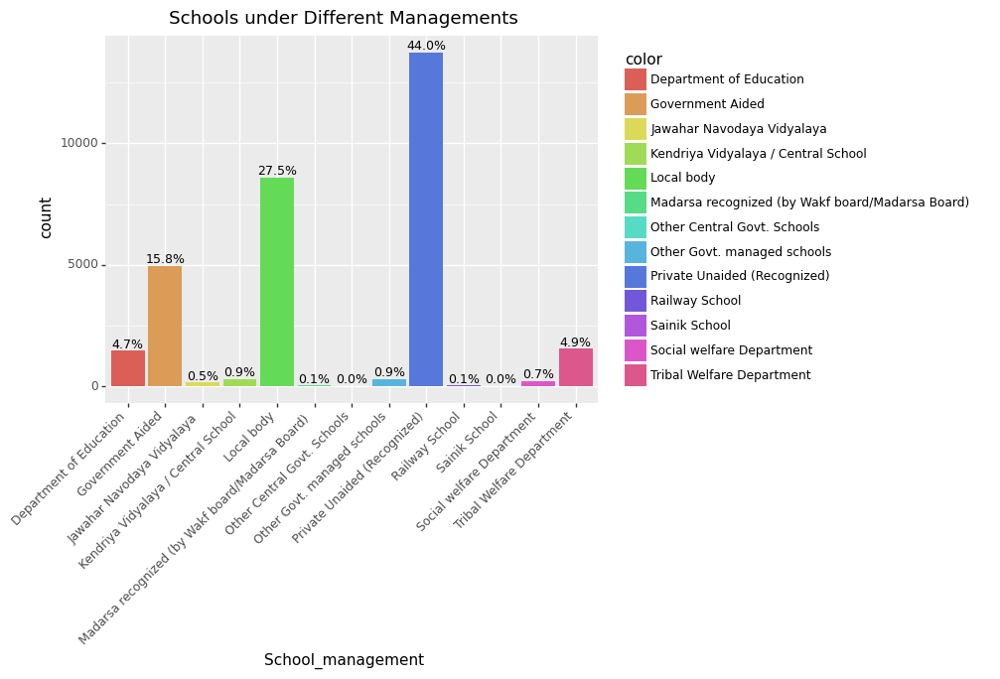

<ggplot: (125467720680)>

In [456]:
SMN= master_df.groupby('School_Management_Name').count().index.tolist()
School_management = pd.Categorical(master_df['School_Management_Name'], categories=SMN)
color=master_df['School_Management_Name']
p9.ggplot(master_df,p9.aes(x='School_management',fill='color'))+p9.geom_bar()+p9.labs( title='Schools under Different Managements')+p9.theme(axis_text_x=p9.element_text(angle=45,hjust=1))+\
p9.geom_text(p9.aes(label=p9.after_stat('prop*100'),group=1),stat='count',nudge_x=0,va='bottom',size=9,format_string='{:.1f}%')


Pie Chart for showing percentage of each school department in gujarat 

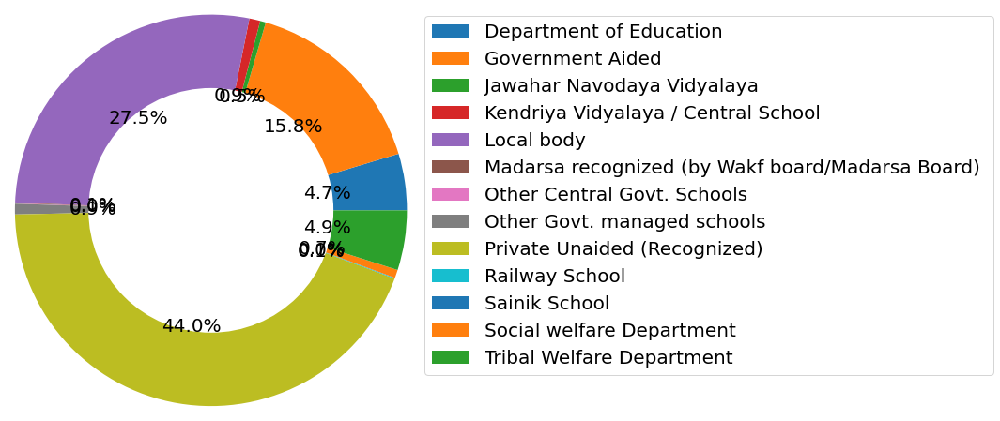

In [460]:
plt.figure(figsize=(8,8))
mylabels= df2.School_Management_Name.unique()
y= df2['No_Of_Schools'].reset_index()
plt.pie(x=y['No_Of_Schools'], autopct='%.1f%%', startangle=0,radius=1.2,textprops={'fontsize': 20})
circle=plt.Circle(xy=(0,0),radius=0.75, facecolor='white')
plt.gca().add_artist(circle)
plt.legend(mylabels,loc='upper left',bbox_to_anchor=(1,1))
plt.show()

Cummulative Percentage of teacher in different School Management

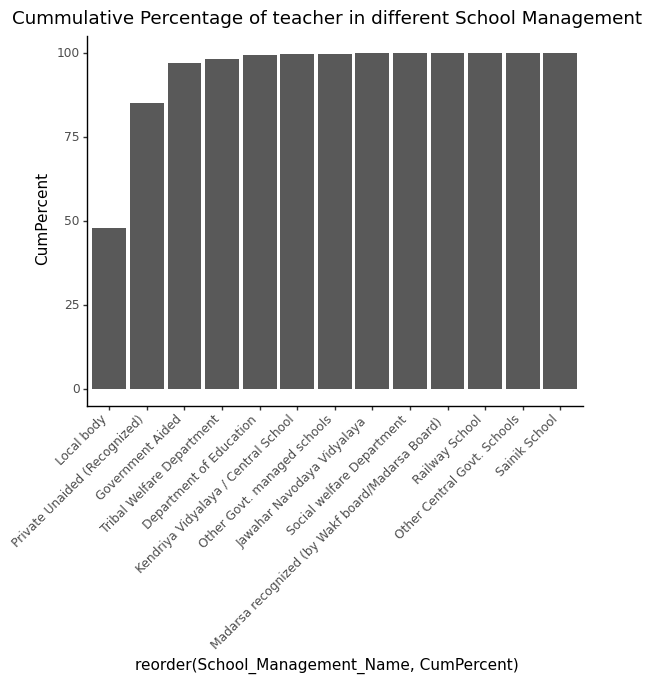

<ggplot: (125468051709)>

In [457]:
p9.ggplot(z,p9.aes(x='reorder(School_Management_Name, CumPercent)',y='CumPercent')) + p9.geom_bar(stat='identity') + p9.theme_classic()+\
p9.theme(axis_text_x =p9.element_text(angle=45,hjust=1))+p9.labs(title='Cummulative Percentage of teacher in different School Management')

Percentage and number of school in each category

In [198]:
SCN=master_df.groupby('School_Category_Name').size().reset_index()
SCN=pd.DataFrame(SCN)
SCN=SCN.rename(columns={0:'Count'})
SCN
p=[]
for i in range (10):
    p= (SCN.Count)*100/SCN.Count.sum()
SCN['Percent']=p
SCN.sort

,School_Category_Name,Count,Percent
0,HSS (I-XII),3023,9.679485
1,HSS (IX-XII),4194,13.428965
2,HSS (VI-XII),903,2.891358
3,HSS (XI-XII),836,2.676828
4,PS (I-V),4258,13.633889
5,SS (I-X),2161,6.919407
6,SS (IX-X),2748,8.798950
7,SS (VI-X),204,0.653197
8,UPS (I-VIII),11458,36.687906
9,UPS (VI-VIII),1446,4.630015


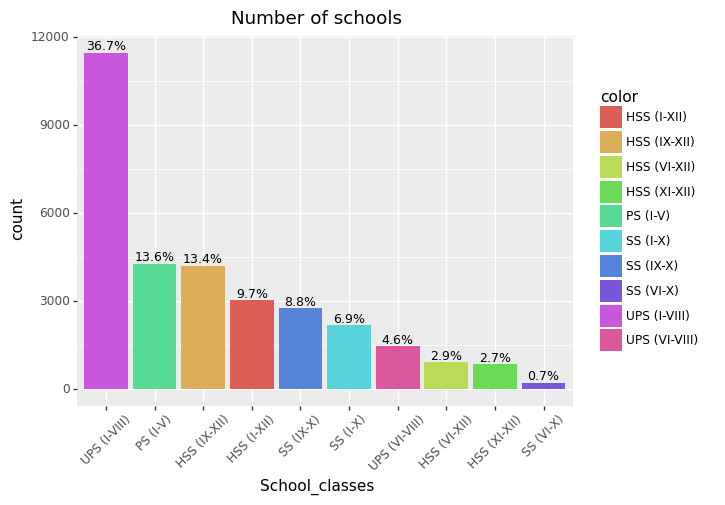

<ggplot: (125447656876)>

In [162]:
SCN_list = master_df['School_Category_Name'].value_counts().index.tolist()
School_classes = pd.Categorical(master_df['School_Category_Name'], categories=SCN_list)
color=master_df['School_Category_Name']
p9.ggplot(master_df,p9.aes(x='School_classes',fill='color'))+p9.geom_bar()+p9.theme(axis_text_x=p9.element_text(angle=45))+ p9.labs( title='Number of schools')+\
p9.geom_text(p9.aes(label=p9.after_stat('prop*100'),group=1),stat='count',nudge_x=0,va='bottom',size=9,format_string='{:.1f}%')

Number of schools in each district

In [458]:
df=master_df.groupby('District_Name')['School_Category_Name'].count().reset_index()
df=pd.DataFrame(df)
df=df.rename(columns={'School_Category_Name':'School_count'})
df=df.sort_values('School_count',ascending=False)
df

,District_Name,School_count
4,BANAS KANTHA,1683
27,SURAT,1658
0,AHMEDABAD,1641
25,RAJKOT,1614
15,KACHCHH,1474
31,VADODARA,1267
28,SURENDRANAGAR,1176
16,KHEDA,1168
6,BHAVNAGAR,1168
2,ANAND,1130


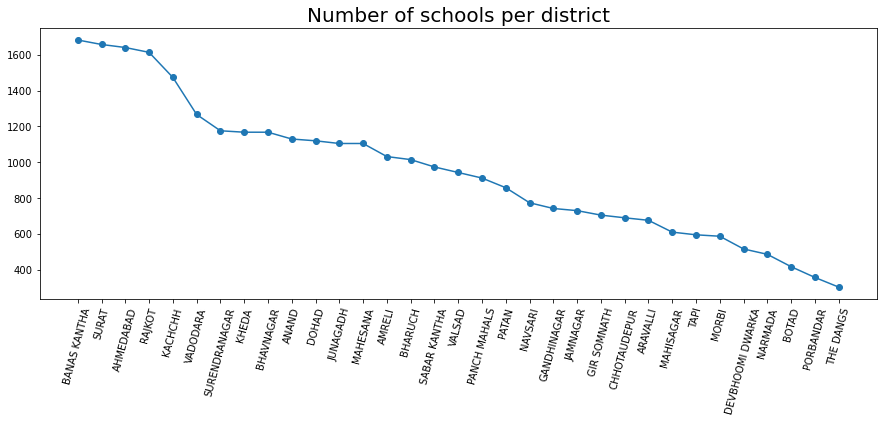

In [459]:
plt.figure(figsize=(15,5))
plt.plot(df.District_Name,df.School_count,marker='o')
plt.xticks(df.District_Name,rotation=75)
plt.title('Number of schools per district',fontsize=20)
plt.show()

Academic Qualification of Teachers

In [352]:
a=master_df.groupby('Academic_Qualification_Name')['Total_Male'].sum()
b=master_df.groupby('Academic_Qualification_Name')['Total_Female'].sum()
df1=pd.concat([a,b],axis=1)
df1=pd.DataFrame(df1)

In [353]:
df1=pd.DataFrame(df1)
df1['Male_Teacher_percent']=round(df1.Total_Male*100/df1.Total_Male.sum(),2)
df1['Female_Teacher_percent']=round(df1.Total_Female*100/df1.Total_Female.sum(),2)
df1

,Total_Male,Total_Female,Male_Teacher_percent,Female_Teacher_percent
Academic_Qualification_Name,,,,
Below Secondary,1189,1821,0.64,0.84
Graduate,64531,85167,35.00,39.52
Higher secondary,25654,31368,13.91,14.56
M.Phil,1286,944,0.70,0.44
Ph.D,668,524,0.36,0.24
Post Doctoral,86,85,0.05,0.04
Post graduate,61233,63378,33.21,29.41
Secondary,29753,32223,16.14,14.95


[0.64, 35.0, 13.91, 0.7, 0.36, 0.05, 33.21, 16.14]
[0 1 2 3 4 5 6 7]


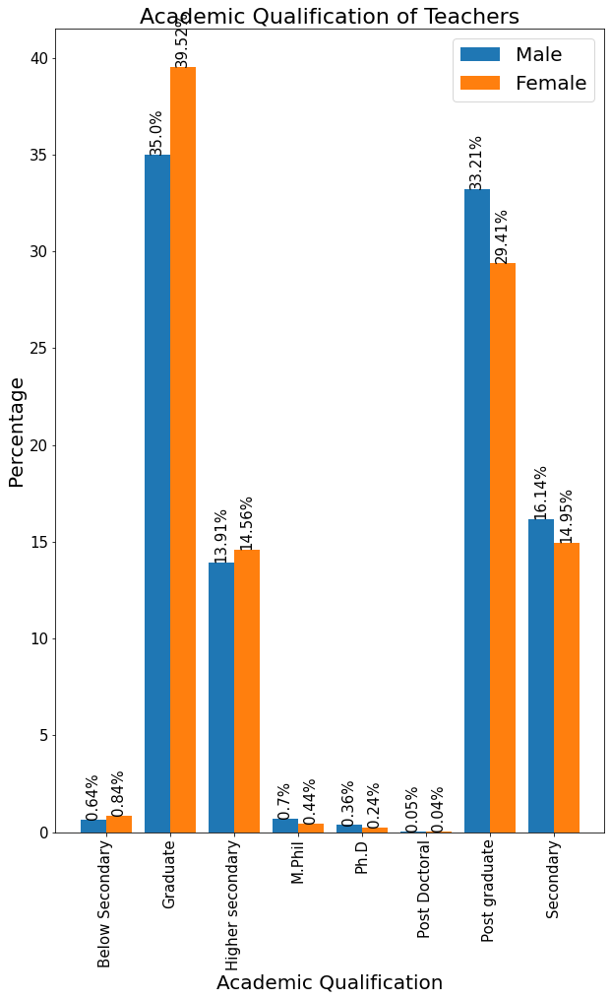

In [354]:
plt.figure(figsize=(10,15))
qualification_list= pd.Categorical(master_df['Academic_Qualification_Name'],categories=master_df['Academic_Qualification_Name'].unique())

male=df1['Male_Teacher_percent'].tolist()
female= df1['Female_Teacher_percent'].tolist()
print(male)
w=0.4
bar1=np.arange(8)
print(bar1)
bar2= [i+w for i in bar1]
plt.bar(bar1,male,w,label='Male')
plt.bar(bar2,female,w,label='Female')

plt.xlabel('Academic Qualification',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.title('Academic Qualification of Teachers',fontsize=22)
plt.xticks(bar1+w/2,df1.index.tolist(),rotation=90,fontsize=15)
plt.yticks(fontsize=15)
for i in range (len(male)):
    plt.text(i,male[i],str(male[i])+'%',rotation=90,ha='center',va='bottom',fontsize=15)
for j in range (len(female)):
    plt.text(j+w,female[j],str(female[j])+'%',rotation=90,ha='center',va='bottom',fontsize=15)
plt.legend()
plt.rcParams["figure.figsize"] = (12,13)
plt.rc('legend',fontsize=20) 
plt.savefig("output.jpg")
plt.show()


Professional Quaification of Teacher

In [355]:
a=master_df.groupby('Professional_Qualification_Name')['Total_Male'].sum()
b=master_df.groupby('Professional_Qualification_Name')['Total_Female'].sum()
df1=pd.concat([a,b],axis=1)
df1=pd.DataFrame(df1)

In [434]:
df1=pd.DataFrame(df1)
df1['Male_Teacher_percent']=round(df1.Total_Male*100/df1.Total_Male.sum(),2)
df1['Female_Teacher_percent']=round(df1.Total_Female*100/df1.Total_Female.sum(),2)
df1=df1.reset_index()
df1

,Professional_Qualification_Name,Total_Male,Total_Female,Male_Teacher_percent,Female_Teacher_percent
0,B.Ed. or equivalent,88782,96698,48.15,44.87
1,Bachelor of Elementary Education (B.El.Ed.),5733,8724,3.11,4.05
2,Diploma or certificate in basic teachers train...,68599,79796,37.20,37.03
3,Diploma/degree in special education,2319,2517,1.26,1.17
4,M.Ed. or equivalent,6871,7169,3.73,3.33
5,None,702,2827,0.38,1.31
6,Others,10524,17003,5.71,7.89
7,Pursuing any relevant professional course,870,776,0.47,0.36


In [ ]:
p9.ggplot(master_df,p9.aes(x='',fill='color'))+p9.geom_bar()+p9.labs( title='Schools under Different Managements')+p9.theme(axis_text_x=p9.element_text(angle=45,hjust=1))+\
p9.geom_text(p9.aes(label=p9.after_stat('prop*100'),group=1),stat='count',nudge_x=0,va='bottom',size=9,format_string='{:.1f}%')


In [435]:
px.bar(df1,x='Professional_Qualification_Name',y=['Male_Teacher_percent','Female_Teacher_percent'],barmode='group')

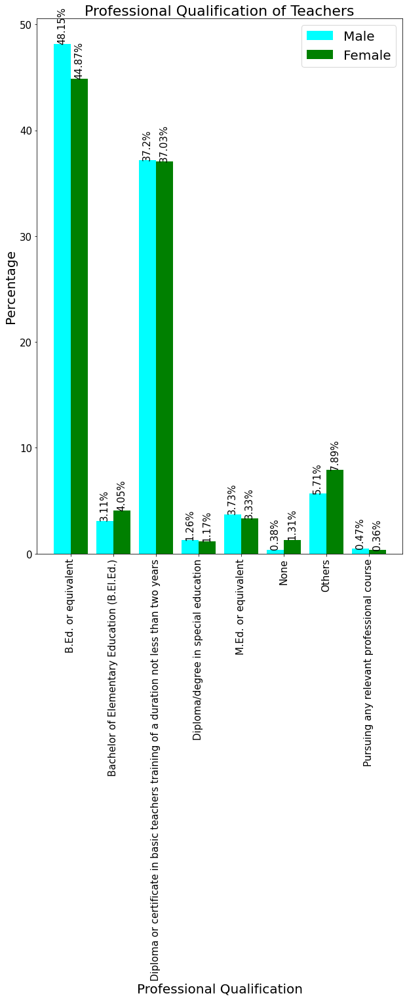

In [359]:
plt.figure(figsize=(10,15))
qualification_list= pd.Categorical(master_df['Professional_Qualification_Name'],categories=master_df['Professional_Qualification_Name'].unique())

male=df1['Male_Teacher_percent'].tolist()
female= df1['Female_Teacher_percent'].tolist()
w=0.4
bar1=np.arange(8)
bar2= [i+w for i in bar1]
plt.bar(bar1,male,w,label='Male',color='cyan')
plt.bar(bar2,female,w,label='Female',color='green')

plt.xlabel('Professional Qualification',fontsize=20)
plt.ylabel('Percentage',fontsize=20)
plt.title('Professional Qualification of Teachers',fontsize=22)
plt.xticks(bar1+w/2,df1.index.tolist(),rotation=90,fontsize=15)
plt.yticks(fontsize=15)
for i in range (len(male)):
    plt.text(i,male[i],str(male[i])+'%',rotation=90,ha='center',va='bottom',fontsize=15)
for j in range (len(female)):
    plt.text(j+w,female[j],str(female[j])+'%',rotation=90,ha='center',va='bottom',fontsize=15)
plt.legend()
plt.rcParams["figure.figsize"] = (12,13)
plt.rc('legend',fontsize=20) 
plt.savefig("output.jpg")
plt.show()


Male and Female teacher count in each district

In [481]:
p=master_df.groupby('District_Name')['Total_Male'].sum()
q=master_df.groupby('District_Name')['Total_Female'].sum()

In [490]:
df3=pd.concat([p,q],axis=1)
df3=pd.DataFrame(df3)
district=df3.index.tolist()
print(district)
df3=df3.reset_index()
df3=df3.sort_values('Total_Female', ascending=False)
df3

['AHMEDABAD', 'AMRELI', 'ANAND', 'ARAVALLI', 'BANAS KANTHA', 'BHARUCH', 'BHAVNAGAR', 'BOTAD', 'CHHOTAUDEPUR', 'DEVBHOOMI DWARKA', 'DOHAD', 'GANDHINAGAR', 'GIR SOMNATH', 'JAMNAGAR', 'JUNAGADH', 'KACHCHH', 'KHEDA', 'MAHESANA', 'MAHISAGAR', 'MORBI', 'NARMADA', 'NAVSARI', 'PANCH MAHALS', 'PATAN', 'PORBANDAR', 'RAJKOT', 'SABAR KANTHA', 'SURAT', 'SURENDRANAGAR', 'TAPI', 'THE DANGS', 'VADODARA', 'VALSAD']


,District_Name,Total_Male,Total_Female
0,AHMEDABAD,12614,26693
27,SURAT,12060,23725
25,RAJKOT,8322,13658
31,VADODARA,5896,12582
15,KACHCHH,7054,9045
4,BANAS KANTHA,15087,8139
32,VALSAD,3855,8104
11,GANDHINAGAR,4118,7981
17,MAHESANA,6085,7273
5,BHARUCH,3900,6571


Text(0.5, 1.0, 'Male and Female Teacher count in each District')

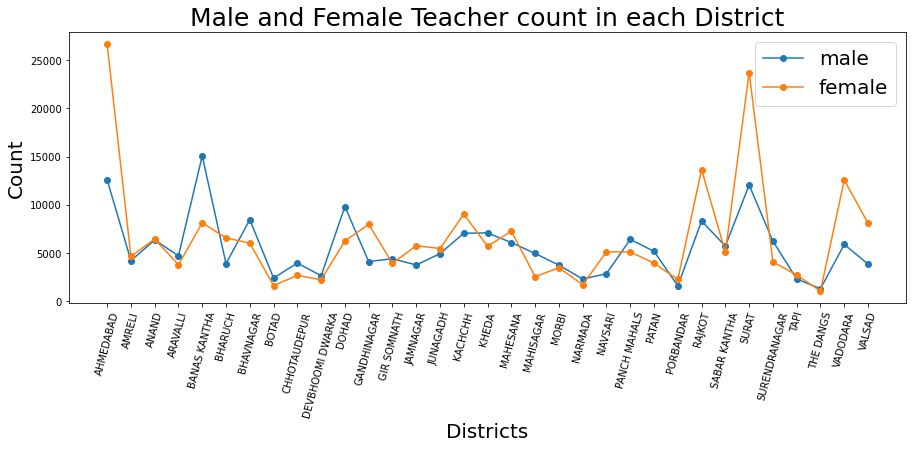

In [483]:
plt.figure(figsize=(15,5))
male=df3['Total_Male'].tolist()
female= df3['Total_Female'].tolist()
bar= np.arange(len(district))
plt.plot(bar,male,marker='o')
plt.plot(bar,female,marker='o')
plt.xticks(bar,district,rotation=75,fontsize=10)
plt.legend(['male','female'])
plt.xlabel('Districts',fontsize=20)
plt.ylabel('Count',fontsize=20)
plt.title('Male and Female Teacher count in each District',fontsize=25)
plt.show()

Male:  154
Female:  2023


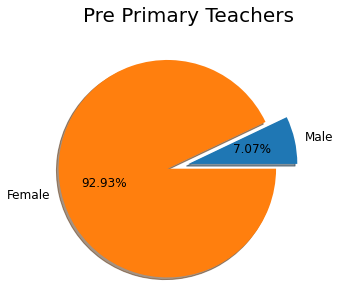

In [383]:
plt.figure(figsize=(5,5))
explode=(0,0.2)
master_df[['Only_Pre_Primary_Male','Only_Pre_Primary_Female']]
print("Male: ",master_df['Only_Pre_Primary_Male'].sum())
print("Female: ",master_df['Only_Pre_Primary_Female'].sum())
total=[master_df['Only_Pre_Primary_Male'].sum(),master_df['Only_Pre_Primary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True)
plt.title("Pre Primary Teachers",fontsize=20)
plt.show()

Male:  515
Female:  2688


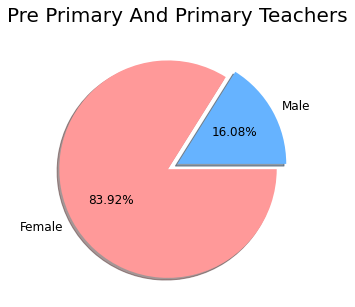

In [412]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['#66b3ff','#ff9999']
master_df[['Pre_Primary_and_Primary_Male','Pre_Primary_and_Primary_Female']]
print("Male: ",master_df['Pre_Primary_and_Primary_Male'].sum())
print("Female: ",master_df['Pre_Primary_and_Primary_Female'].sum())
total=[master_df['Pre_Primary_and_Primary_Male'].sum(),master_df['Pre_Primary_and_Primary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Pre Primary And Primary Teachers",fontsize=20)
plt.show()

Male:  69713
Female:  105610


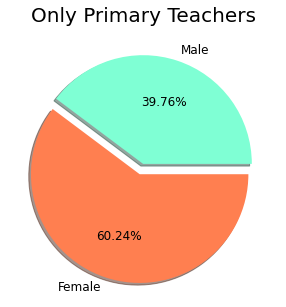

In [424]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['aquamarine','coral']
master_df[['Only_Primary_Male','Only_Primary_Female']]
print("Male: ",master_df['Only_Primary_Male'].sum())
print("Female: ",master_df['Only_Primary_Female'].sum())
total=[master_df['Only_Primary_Male'].sum(),master_df['Only_Primary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Only Primary Teachers",fontsize=20)
plt.show()

Male:  2149
Female:  4745


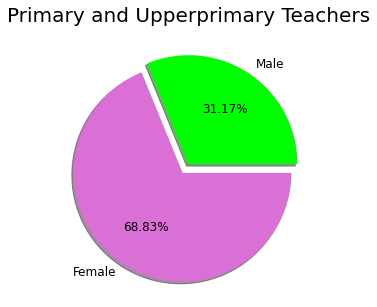

In [425]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['lime','orchid']
master_df[['Primary_and_Upperprimary_Male','Primary_and_Upperprimary_Female']]
print("Male: ",master_df['Primary_and_Upperprimary_Male'].sum())
print("Female: ",master_df['Primary_and_Upperprimary_Female'].sum())
total=[master_df['Primary_and_Upperprimary_Male'].sum(),master_df['Primary_and_Upperprimary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Primary and Upperprimary Teachers",fontsize=20)
plt.show()

Male:  56390
Female:  66952


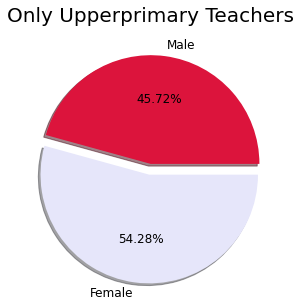

In [427]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['crimson','lavender']
master_df[['Only_Upperprimary_Male','Only_Upperprimary_Female']]
print("Male: ",master_df['Only_Upperprimary_Male'].sum())
print("Female: ",master_df['Only_Upperprimary_Female'].sum())
total=[master_df['Only_Upperprimary_Male'].sum(),master_df['Only_Upperprimary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Only Upperprimary Teachers",fontsize=20)
plt.show()

Male:  974
Female:  1361


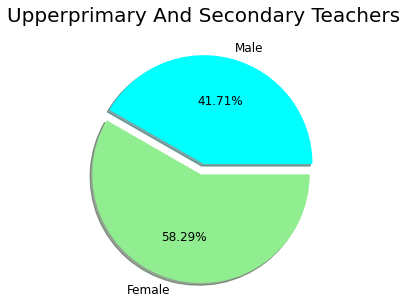

In [428]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['aqua','lightgreen']
master_df[['Upperprimary_and_Secondary_Male','Upperprimary_and_Secondary_Female']]
print("Male: ",master_df['Upperprimary_and_Secondary_Male'].sum())
print("Female: ",master_df['Upperprimary_and_Secondary_Female'].sum())
total=[master_df['Upperprimary_and_Secondary_Male'].sum(),master_df['Upperprimary_and_Secondary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Upperprimary And Secondary Teachers",fontsize=20)
plt.show()

Male:  31503
Female:  17812


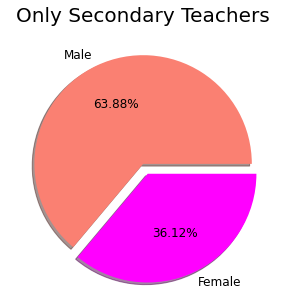

In [430]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['salmon','magenta']
master_df[['Only_Secondary_Male','Only_Secondary_Female']]
print("Male: ",master_df['Only_Secondary_Male'].sum())
print("Female: ",master_df['Only_Secondary_Female'].sum())
total=[master_df['Only_Secondary_Male'].sum(),master_df['Only_Secondary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Only Secondary Teachers",fontsize=20)
plt.show()

Male:  2473
Female:  1886


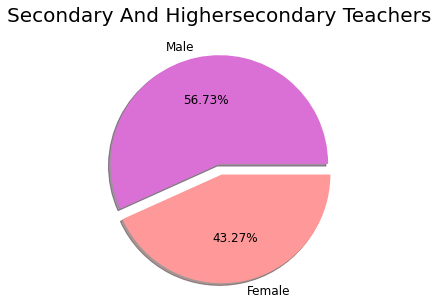

In [431]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['orchid','#ff9999']
master_df[['Secondary_and_Highersecondary_Male','Secondary_and_Highersecondary_Female']]
print("Male: ",master_df['Secondary_and_Highersecondary_Male'].sum())
print("Female: ",master_df['Secondary_and_Highersecondary_Female'].sum())
total=[master_df['Secondary_and_Highersecondary_Male'].sum(),master_df['Secondary_and_Highersecondary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Secondary And Highersecondary Teachers",fontsize=20)
plt.show()

Male:  20529
Female:  12433


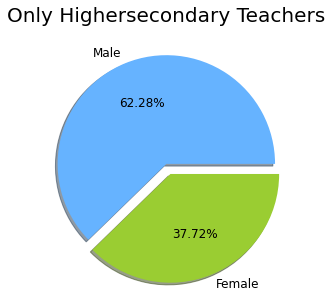

In [432]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['#66b3ff','yellowgreen']
master_df[['Only_Highersecondary_Male','Only_Highersecondary_Female']]
print("Male: ",master_df['Only_Highersecondary_Male'].sum())
print("Female: ",master_df['Only_Highersecondary_Female'].sum())
total=[master_df['Only_Highersecondary_Male'].sum(),master_df['Only_Highersecondary_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Only Highersecondary Teachers",fontsize=20)
plt.show()

Male:  184400
Female:  215510


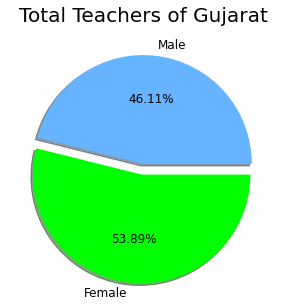

In [502]:
plt.figure(figsize=(5,5))
explode=(0,0.1)
colors=['#66b3ff','lime']
master_df[['Only_Highersecondary_Male','Only_Highersecondary_Female']]
print("Male: ",master_df['Total_Male'].sum())
print("Female: ",master_df['Total_Female'].sum())
total=[master_df['Total_Male'].sum(),master_df['Total_Female'].sum()]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius=1,explode=explode,shadow=True,colors=colors)
plt.title("Total Teachers of Gujarat",fontsize=20)
plt.show()

District: TAPI


Text(0.5, 1.0, 'Total Teachers In District ')

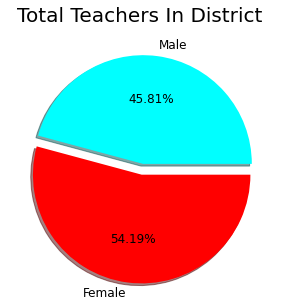

In [476]:
a= master_df.groupby('District_Name').sum()
district=input('District: ')
plt.figure(figsize=(5,5))
p=a.loc[district, 'Total_Male']
q=a.loc[district, 'Total_Female']
total=[p,q]
label=['Male','Female']
plt.pie(total,labels=label,autopct='%.2f%%',textprops={'fontsize': 12},radius =1,explode=explode,shadow=True,colors=colors)
plt.title("Total Teachers In District ",fontsize=20)

In [493]:
school3= pd.crosstab(master_df.School_Management_Name,master_df.School_Category_Name)
#school3=school3.reset_index()
school3


School_Category_Name,HSS (I-XII),HSS (IX-XII),HSS (VI-XII),HSS (XI-XII),PS (I-V),SS (I-X),SS (IX-X),SS (VI-X),UPS (I-VIII),UPS (VI-VIII)
School_Management_Name,,,,,,,,,,
Department of Education,0,325,177,229,0,0,702,21,1,3
Government Aided,68,2368,222,60,138,7,1120,45,430,482
Jawahar Navodaya Vidyalaya,0,0,126,0,0,0,0,7,0,13
Kendriya Vidyalaya / Central School,240,0,0,0,0,34,0,0,7,0
Local body,0,94,0,0,2358,0,71,6,5923,137
Madarsa recognized (by Wakf board/Madarsa Board),15,0,0,0,0,4,0,0,0,0
Other Central Govt. Schools,12,0,0,0,0,0,0,0,0,0
Other Govt. managed schools,0,0,0,0,0,0,0,16,4,256
Private Unaided (Recognized),2661,1213,194,547,1760,1996,711,46,4080,531


In [408]:
px.bar(school3,x='School_Management_Name',y=['HSS (I-XII)','HSS (IX-XII)','HSS (VI-XII)','HSS (XI-XII)','PS (I-V)','SS (I-X)','SS (IX-X)','SS (VI-X)','UPS (I-VIII)','UPS (VI-VIII)'])

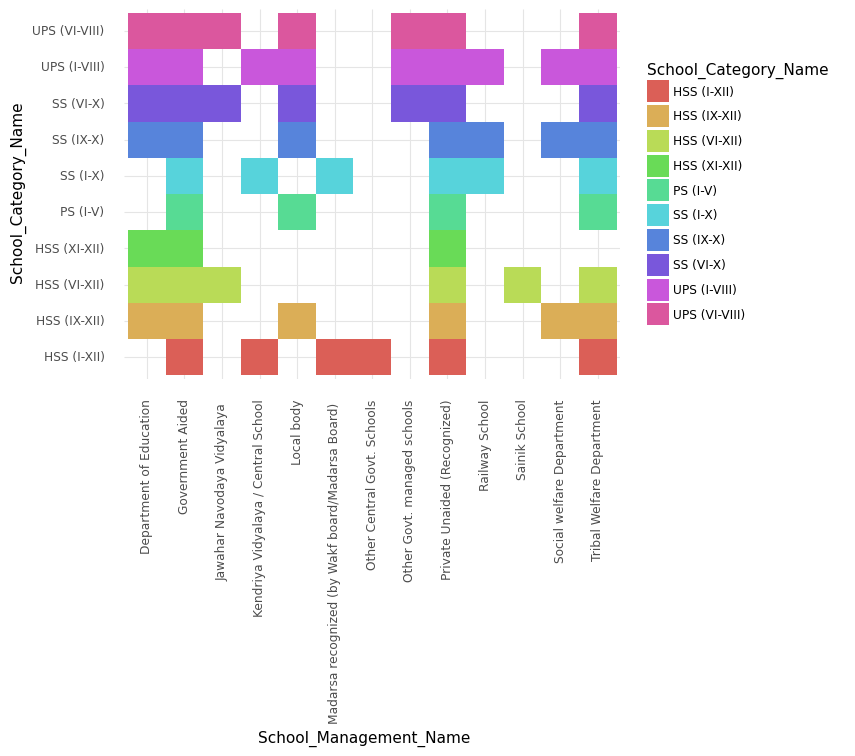

<ggplot: (125453628919)>

In [136]:
p9.ggplot(master_df, p9.aes(x='School_Management_Name', y='School_Category_Name'))+p9.geom_tile(p9.aes(fill='School_Category_Name'))+\
p9.theme_minimal()+p9.theme(axis_text_x=p9.element_text(angle=90))

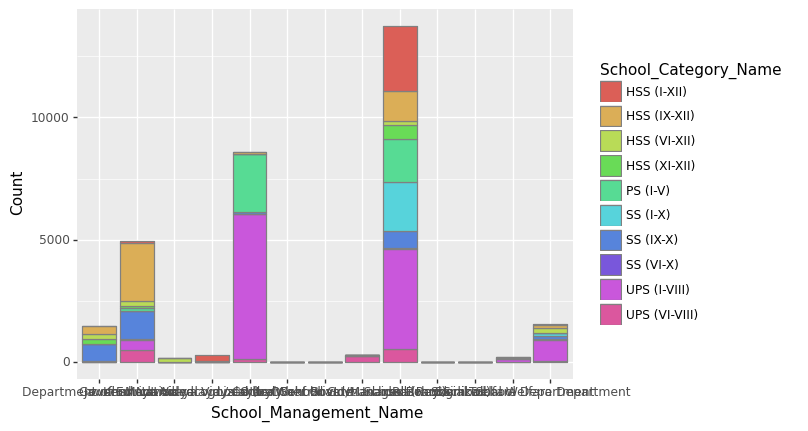

<ggplot: (150308921510)>

In [33]:
P = school.stack().reset_index()
P.columns=['School_Category_Name', '', 'Count']
p9.ggplot(P, p9.aes(x='School_Management_Name', y='Count', fill='School_Category_Name'))+\
p9.geom_bar(stat="identity", color='grey')

In [499]:
school2= pd.crosstab(master_df.Academic_Qualification_Name, master_df.Professional_Qualification_Name)
school2=school2.reset_index()
school2

Professional_Qualification_Name,Academic_Qualification_Name,B.Ed. or equivalent,Bachelor of Elementary Education (B.El.Ed.),Diploma or certificate in basic teachers training of a duration not less than two years,Diploma/degree in special education,M.Ed. or equivalent,None,Others,Pursuing any relevant professional course
0,Below Secondary,120,72,475,19,16,9,92,10
1,Graduate,3272,1188,1772,809,1018,357,1617,293
2,Higher secondary,884,573,1502,317,199,123,870,264
3,M.Phil,711,49,64,20,330,23,77,9
4,Ph.D,390,21,54,61,201,8,64,7
5,Post Doctoral,69,6,12,11,14,1,15,12
6,Post graduate,3546,923,1266,537,1743,261,1252,138
7,Secondary,545,505,1193,206,96,57,656,207


In [500]:
px.bar(school2,x='Academic_Qualification_Name',y=['B.Ed. or equivalent','Bachelor of Elementary Education (B.El.Ed.)','Diploma or certificate in basic teachers training of a duration not less than two years','Diploma/degree in special education','M.Ed. or equivalent','None','Others','Pursuing any relevant professional course'])

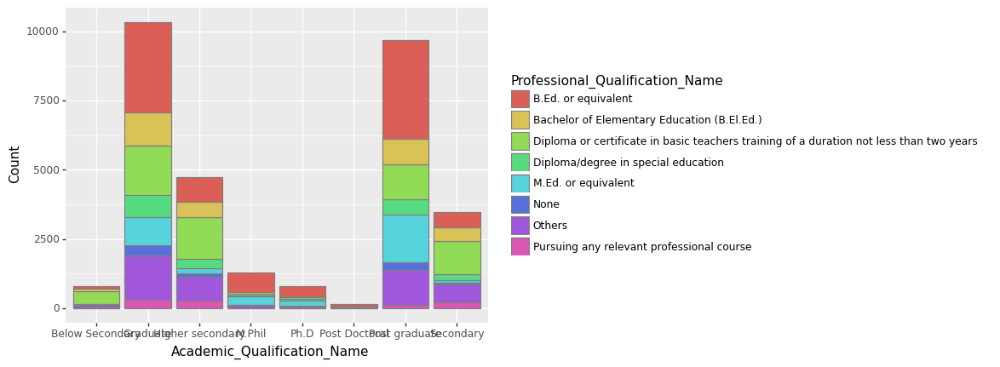

<ggplot: (150308998352)>

In [37]:
P = school.stack().reset_index()
P.columns=['Academic_Qualification_Name', 'Professional_Qualification_Name', 'Count']
p9.ggplot(P, p9.aes(x='Academic_Qualification_Name', y='Count', fill='Professional_Qualification_Name'))+\
p9.geom_bar(stat="identity", color='grey')

In [35]:
school= pd.crosstab(master_df.School_Management_Name,master_df.School_Category_Name,normalize='columns')
school_df = school.stack().reset_index()
school_df.columns=["School Management", "School Category", "NormalizedCounts"]
'''dayorder = pd.CategoricalDtype(["day", "afternoon", "evening", "night"], ordered=True)
CrimeDay_df['DayTime-O'] = CrimeDay_df.DayTime.astype(dayorder)'''
display(school_df)
#idx = school_df.sort_values(by=['School Category'], ascending=True).index

,School Management,School Category,NormalizedCounts
0,Department of Education,HSS (I-XII),0.000000
1,Department of Education,HSS (IX-XII),0.077492
2,Department of Education,HSS (VI-XII),0.196013
3,Department of Education,HSS (XI-XII),0.273923
4,Department of Education,PS (I-V),0.000000
...,...,...,...
125,Tribal Welfare Department,SS (I-X),0.049977
126,Tribal Welfare Department,SS (IX-X),0.044396
127,Tribal Welfare Department,SS (VI-X),0.308824
128,Tribal Welfare Department,UPS (I-VIII),0.076104


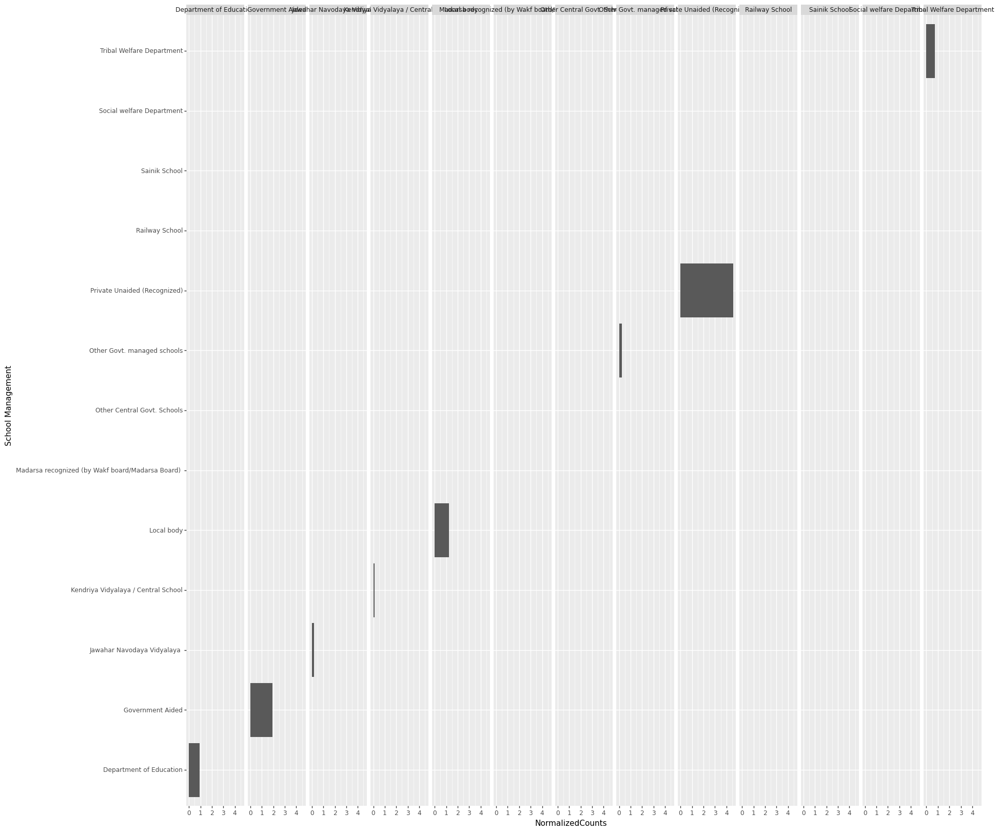

<ggplot: (125447744220)>

In [95]:
p9.ggplot(school_df, p9.aes(x='School Management',y='NormalizedCounts'))+\
p9.theme(figure_size = (20, 20))+\
p9.geom_bar(stat='identity')+\
p9.facet_grid('.~School Management')+\
p9.coord_flip()

In [280]:
df=master_df.groupby('District_Name')['School_Category_Name'].value_counts()
df=pd.DataFrame(df)
df.iloc[39:49]

School_Category_Name
District_Name School_Category_Name                      
BANAS KANTHA  UPS (I-VIII)                           647
              PS (I-V)                               282
              HSS (IX-XII)                           233
              SS (IX-X)                              152
              UPS (VI-VIII)                          104
              HSS (I-XII)                             79
              HSS (VI-XII)                            76
              SS (I-X)                                65
              HSS (XI-XII)                            30
              SS (VI-X)                               15